In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import MinMaxScaler, StandardScaler
plt.rcParams['figure.figsize'] = (12,10) # RuntimeConfiguration Parameters: size of graph, 10:width, 5:height
plt.rcParams['figure.dpi'] = 300 # Resolution dots per inches


In [ ]:
df = pd.read_csv("/content/Bankruptcy Prediction (1).csv")

In [ ]:
df.shape

(6819, 96)

In [ ]:
df.head()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1,0.035490


In [ ]:
df.tail()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
6814,0,0.493687,0.539468,0.543230,0.604455,0.604462,0.998992,0.797409,0.809331,0.303510,...,0.799927,0.000466,0.623620,0.604455,0.840359,0.279606,0.027064,0.566193,1,0.029890
6815,0,0.475162,0.538269,0.524172,0.598308,0.598308,0.998992,0.797414,0.809327,0.303520,...,0.799748,0.001959,0.623931,0.598306,0.840306,0.278132,0.027009,0.566018,1,0.038284
6816,0,0.472725,0.533744,0.520638,0.610444,0.610213,0.998984,0.797401,0.809317,0.303512,...,0.797778,0.002840,0.624156,0.610441,0.840138,0.275789,0.026791,0.565158,1,0.097649
6817,0,0.506264,0.559911,0.554045,0.607850,0.607850,0.999074,0.797500,0.809399,0.303498,...,0.811808,0.002837,0.623957,0.607846,0.841084,0.277547,0.026822,0.565302,1,0.044009
6818,0,0.493053,0.570105,0.549548,0.627409,0.627409,0.998080,0.801987,0.813800,0.313415,...,0.815956,0.000707,0.626680,0.627408,0.841019,0.275114,0.026793,0.565167,1,0.233902


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2503 entries, 0 to 2502
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 2503 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  2503 non-null   float64
 2    ROA(A) before interest and % after tax                   2503 non-null   float64
 3    ROA(B) before interest and depreciation after tax        2503 non-null   float64
 4    Operating Gross Margin                                   2503 non-null   float64
 5    Realized Sales Gross Margin                              2503 non-null   float64
 6    Operating Profit Rate                                    2503 non-null   float64
 7    Pre-tax net Interest Rate                                2503 non-null   float64
 8    After-tax net Int

In [ ]:
df.describe()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
count,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,...,2503.000000,2.503000e+03,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2503.000000,2502.0,2502.000000
mean,0.059928,0.489142,0.544412,0.537806,0.605224,0.605204,0.998893,0.797381,0.809295,0.303670,...,0.799503,1.622453e+07,0.623751,0.605223,0.839592,0.281637,0.028318,0.565250,1.0,0.041669
std,0.237401,0.053168,0.059644,0.054730,0.020911,0.020892,0.001300,0.004573,0.004392,0.009185,...,0.040958,3.574091e+08,0.012272,0.020911,0.022406,0.020740,0.024113,0.019557,0.0,0.053635
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.964194,0.752969,0.761550,0.235090,...,0.000000,0.000000e+00,0.408682,0.000000,0.000000,0.000000,0.000789,0.000000,1.0,0.008500
25%,0.000000,0.468898,0.529328,0.519996,0.598942,0.598953,0.998957,0.797355,0.809285,0.303452,...,0.792358,9.855338e-04,0.623344,0.598940,0.839760,0.277575,0.026786,0.565158,1.0,0.022034
50%,0.000000,0.490859,0.550153,0.541624,0.603821,0.603799,0.999005,0.797433,0.809350,0.303518,...,0.804201,2.584608e-03,0.623755,0.603823,0.840752,0.279787,0.026835,0.565401,1.0,0.029101
75%,0.000000,0.513382,0.570404,0.563092,0.610231,0.610192,0.999057,0.797514,0.809418,0.303569,...,0.816271,6.605731e-03,0.624072,0.610231,0.841680,0.282855,0.027048,0.566255,1.0,0.043603
max,1.000000,0.733194,0.771696,0.763745,1.000000,1.000000,0.999650,1.000000,1.000000,0.730252,...,0.905538,9.820000e+09,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000


In [ ]:
df.columns

Index(['Bankrupt?', ' ROA(C) before interest and depreciation before interest',
       ' ROA(A) before interest and % after tax',
       ' ROA(B) before interest and depreciation after tax',
       ' Operating Gross Margin', ' Realized Sales Gross Margin',
       ' Operating Profit Rate', ' Pre-tax net Interest Rate',
       ' After-tax net Interest Rate',
       ' Non-industry income and expenditure/revenue',
       ' Continuous interest rate (after tax)', ' Operating Expense Rate',
       ' Research and development expense rate', ' Cash flow rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Net Value Per Share (B)', ' Net Value Per Share (A)',
       ' Net Value Per Share (C)', ' Persistent EPS in the Last Four Seasons',
       ' Cash Flow Per Share', ' Revenue Per Share (Yuan ¥)',
       ' Operating Profit Per Share (Yuan ¥)',
       ' Per Share Net profit before tax (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate',
       ' Operating Profit

In [ ]:
df.dtypes

Bankrupt?                                                     int64
 ROA(C) before interest and depreciation before interest    float64
 ROA(A) before interest and % after tax                     float64
 ROA(B) before interest and depreciation after tax          float64
 Operating Gross Margin                                     float64
                                                             ...   
 Liability to Equity                                        float64
 Degree of Financial Leverage (DFL)                         float64
 Interest Coverage Ratio (Interest expense to EBIT)         float64
 Net Income Flag                                            float64
 Equity to Liability                                        float64
Length: 96, dtype: object

Checking Missing Values

In [ ]:
df.isnull().sum()

Bankrupt?                                                   0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
                                                           ..
 Liability to Equity                                        0
 Degree of Financial Leverage (DFL)                         0
 Interest Coverage Ratio (Interest expense to EBIT)         0
 Net Income Flag                                            1
 Equity to Liability                                        1
Length: 96, dtype: int64

In [ ]:
# % of missing values
for i in df.isna().sum():
  print((i/len(df))*100)

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.03995205753096284
0.03995205753096284


<Axes: >

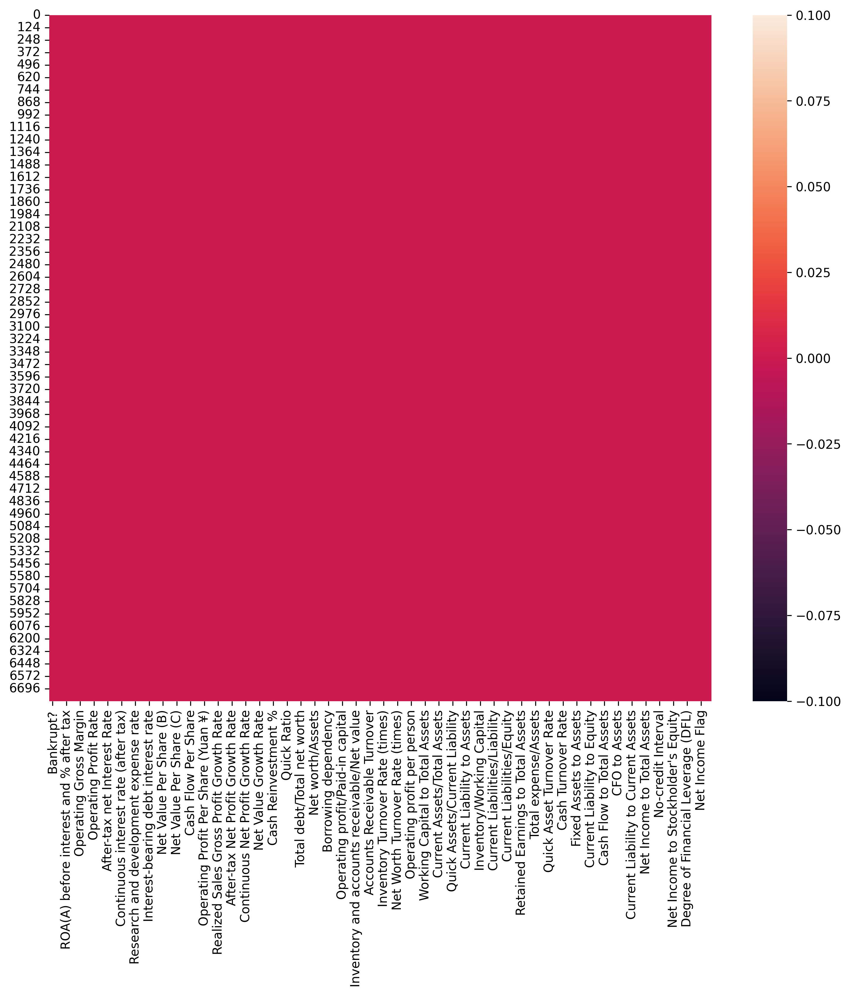

In [ ]:
# visualizing missing values by using heatmap
sns.heatmap(df.isna())

In [ ]:
#Replace the missing value with '0' using 'fiilna' method
df = df.fillna(0)
df

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,...,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1.0,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,...,0.795297,0.008323,0.623652,0.610237,0.839969,0.283846,0.264577,0.570175,1.0,0.020794
2,1,0.426071,0.499019,0.472295,0.601450,0.601364,0.998857,0.796403,0.808388,0.302035,...,0.774670,0.040003,0.623841,0.601449,0.836774,0.290189,0.026555,0.563706,1.0,0.016474
3,1,0.399844,0.451265,0.457733,0.583541,0.583541,0.998700,0.796967,0.808966,0.303350,...,0.739555,0.003252,0.622929,0.583538,0.834697,0.281721,0.026697,0.564663,1.0,0.023982
4,1,0.465022,0.538432,0.522298,0.598783,0.598783,0.998973,0.797366,0.809304,0.303475,...,0.795016,0.003878,0.623521,0.598782,0.839973,0.278514,0.024752,0.575617,1.0,0.035490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2498,0,0.486033,0.535488,0.537556,0.598084,0.598084,0.998942,0.797422,0.809344,0.303638,...,0.798115,0.085852,0.624423,0.598083,0.840188,0.277920,0.027142,0.566415,1.0,0.040117
2499,0,0.571296,0.635031,0.619573,0.642824,0.642824,0.999650,0.800552,0.812098,0.307626,...,0.857531,0.013680,0.632213,0.642825,0.843386,0.275898,0.026799,0.565194,1.0,0.089814
2500,0,0.611368,0.684420,0.668933,0.620714,0.620714,0.999298,0.801937,0.813390,0.310781,...,0.874161,0.038926,0.599075,0.620713,0.845767,0.278618,0.026816,0.565273,1.0,0.034821
2501,0,0.491103,0.553914,0.539376,0.603612,0.603612,0.999088,0.797721,0.809562,0.303856,...,0.809730,0.019875,0.633400,0.603609,0.840763,0.275625,0.026793,0.565166,1.0,0.112845


In [ ]:
df.isnull().sum()

Bankrupt?                                                   0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
                                                           ..
 Liability to Equity                                        0
 Degree of Financial Leverage (DFL)                         0
 Interest Coverage Ratio (Interest expense to EBIT)         0
 Net Income Flag                                            0
 Equity to Liability                                        0
Length: 96, dtype: int64

Checking for Duplicate Values

In [ ]:
df.duplicated().sum()

0

Correlation Analysis

In [ ]:
correlation_matrix = df.corr()
correlation_matrix

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,...,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
Bankrupt?,1.000000,-0.308273,-0.323219,-0.310565,-0.079888,-0.079148,-0.027029,-0.048369,-0.057617,-0.034075,...,-0.320713,0.039645,-0.001961,-0.079889,-0.154168,0.163135,0.005484,-0.002204,0.005048,-0.072304
ROA(C) before interest and depreciation before interest,-0.308273,1.000000,0.935974,0.987207,0.227671,0.226415,0.219802,0.125212,0.119484,0.043855,...,0.861775,-0.101195,0.014626,0.227670,0.230057,-0.120783,-0.008615,0.016512,-0.004551,-0.018392
ROA(A) before interest and % after tax,-0.323219,0.935974,1.000000,0.952656,0.230084,0.229024,0.222062,0.139458,0.134635,0.055577,...,0.940270,-0.108575,0.006059,0.230083,0.233145,-0.114071,-0.003102,0.020295,-0.003204,-0.001944
ROA(B) before interest and depreciation after tax,-0.310565,0.987207,0.952656,1.000000,0.225099,0.223910,0.221105,0.130705,0.126810,0.048248,...,0.885617,-0.099373,0.011613,0.225098,0.229943,-0.114441,-0.006303,0.017614,-0.003449,-0.015424
Operating Gross Margin,-0.079888,0.227671,0.230084,0.225099,1.000000,0.999821,0.070406,0.176992,0.176093,0.133122,...,0.192612,0.038989,0.007249,1.000000,0.032176,-0.030271,-0.007333,-0.000267,-0.041716,-0.090360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Liability to Equity,0.163135,-0.120783,-0.114071,-0.114441,-0.030271,-0.030099,0.009116,-0.006843,-0.009667,-0.008652,...,-0.132848,0.034489,-0.006537,-0.030270,-0.833373,1.000000,-0.002255,0.002816,0.003330,-0.109560
Degree of Financial Leverage (DFL),0.005484,-0.008615,-0.003102,-0.006303,-0.007333,-0.006593,0.005659,0.000427,0.000658,-0.001304,...,-0.002401,-0.002836,-0.014526,-0.007334,0.001943,-0.002255,1.000000,0.015822,0.001190,-0.013354
Interest Coverage Ratio (Interest expense to EBIT),-0.002204,0.016512,0.020295,0.017614,-0.000267,-0.000391,0.001590,0.002705,0.003055,0.001883,...,0.016696,-0.000082,0.003723,-0.000269,0.003852,0.002816,0.015822,1.000000,-0.000321,-0.008324
Net Income Flag,0.005048,-0.004551,-0.003204,-0.003449,-0.041716,-0.041774,-0.002324,-0.000513,-0.000499,0.000241,...,-0.004787,0.000908,-0.000012,-0.041715,-0.001237,0.003330,0.001190,-0.000321,1.000000,0.015530


<Axes: >

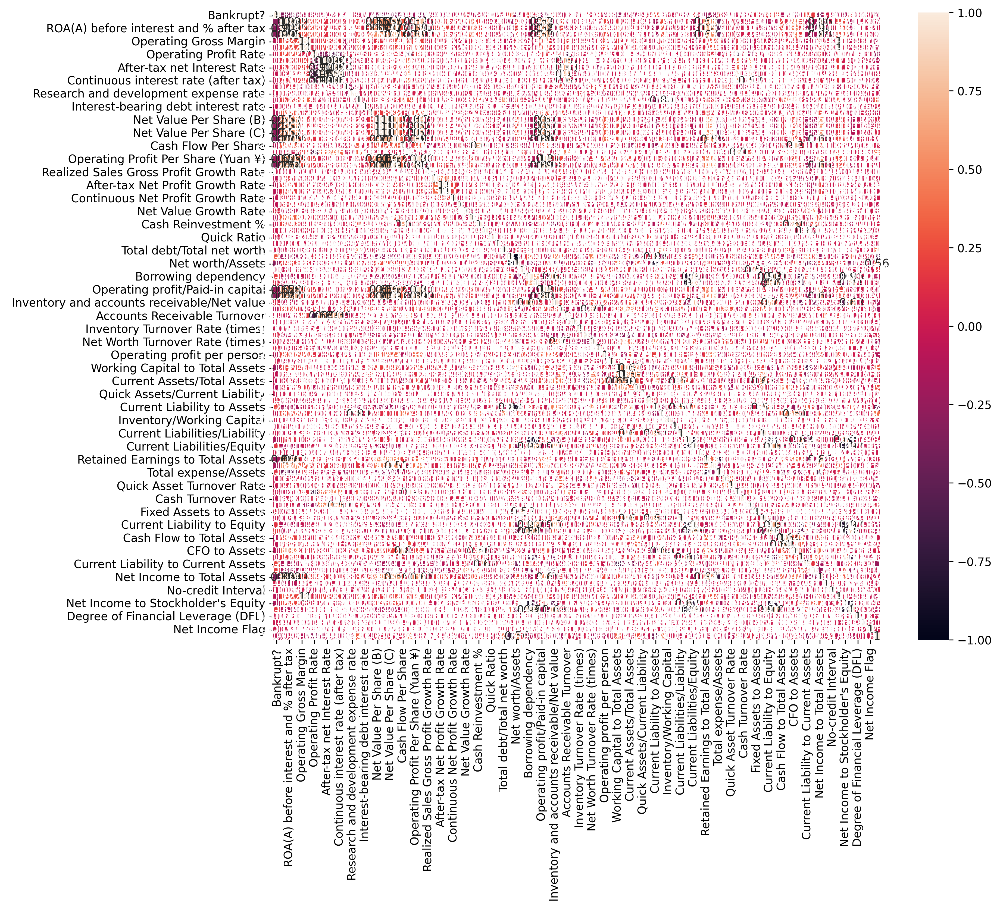

In [ ]:
sns.heatmap(df.corr(),annot = True)

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Drop target variable and non-numeric columns for VIF calculation
X = df.drop(columns=['Bankrupt?'])
X_numeric = X.select_dtypes(include=[np.number])  # Select only numeric columns

Features with VIF values greater than 10 indicate high multicollinearity. These features may need to be removed or transformed to improve the model.

In [ ]:
print(df['Bankrupt?'] ==  1)

0        True
1        True
2        True
3        True
4        True
        ...  
2498    False
2499    False
2500    False
2501    False
2502    False
Name: Bankrupt?, Length: 2503, dtype: bool


In [ ]:
def calculate_vif(df):
    vif_data = pd.DataFrame()  #Empty dataFrame
    vif_data['Feature'] = df.columns
    vif_data['VIF'] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]  #VIF value is caluculated
    return vif_data

# Initial VIF calculation
vif_data = calculate_vif(X_numeric)
print("Initial VIF values:")
print(vif_data)



Initial VIF values:
                                              Feature           VIF
0    ROA(C) before interest and depreciation befor...  9.124188e+01
1              ROA(A) before interest and % after tax  5.293556e+01
2    ROA(B) before interest and depreciation after...  1.645414e+02
3                              Operating Gross Margin  8.707792e+07
4                         Realized Sales Gross Margin  2.905024e+03
..                                                ...           ...
90                                Liability to Equity  8.284186e+02
91                 Degree of Financial Leverage (DFL)  1.010851e+00
92   Interest Coverage Ratio (Interest expense to ...  1.020210e+00
93                                    Net Income Flag  1.015768e+00
94                                Equity to Liability  5.538165e+00

[95 rows x 2 columns]


In [ ]:
# Iteratively remove features with high VIF
threshold = 10  # VIF threshold
while vif_data['VIF'].max() > threshold:
    feature_to_drop = vif_data.loc[vif_data['VIF'].idxmax(), 'Feature']
    if feature_to_drop in X_numeric.columns:
        X_numeric = X_numeric.drop(columns=[feature_to_drop])
        vif_data = calculate_vif(X_numeric)
        print(f"Dropped {feature_to_drop}, recalculated VIF:")
        print(vif_data)
    else:
        print(f"Feature {feature_to_drop} not found in DataFrame columns.")
        break

Dropped  Current Liability to Liability, recalculated VIF:
                                              Feature           VIF
0    ROA(C) before interest and depreciation befor...  9.124407e+01
1              ROA(A) before interest and % after tax  5.293550e+01
2    ROA(B) before interest and depreciation after...  1.645419e+02
3                              Operating Gross Margin  8.948384e+07
4                         Realized Sales Gross Margin  2.905023e+03
..                                                ...           ...
89                                Liability to Equity  8.284192e+02
90                 Degree of Financial Leverage (DFL)  1.010851e+00
91   Interest Coverage Ratio (Interest expense to ...  1.020210e+00
92                                    Net Income Flag  1.015768e+00
93                                Equity to Liability  5.538168e+00

[94 rows x 2 columns]
Dropped  Working Capital to Total Assets, recalculated VIF:
                                          

In [ ]:
# Print final set of features
print("Final set of features after removing high VIF values:")
print(X_numeric.columns)
X_numeric.shape

Final set of features after removing high VIF values:
Index([' ROA(C) before interest and depreciation before interest',
       ' After-tax net Interest Rate', ' Operating Expense Rate',
       ' Research and development expense rate',
       ' Interest-bearing debt interest rate', ' Tax rate (A)',
       ' Revenue Per Share (Yuan ¥)', ' Operating Profit Per Share (Yuan ¥)',
       ' Realized Sales Gross Profit Growth Rate', ' Total Asset Growth Rate',
       ' Net Value Growth Rate', ' Cash Reinvestment %', ' Current Ratio',
       ' Quick Ratio', ' Total debt/Total net worth',
       ' Long-term fund suitability ratio (A)',
       ' Contingent liabilities/Net worth',
       ' Net profit before tax/Paid-in capital', ' Total Asset Turnover',
       ' Accounts Receivable Turnover', ' Average Collection Days',
       ' Inventory Turnover Rate (times)', ' Fixed Assets Turnover Frequency',
       ' Net Worth Turnover Rate (times)', ' Revenue per person',
       ' Operating profit per perso

(2503, 51)

In [ ]:
df2 = pd.concat([X_numeric, df[['Bankrupt?']]], axis=1)
df2

,ROA(C) before interest and depreciation before interest,After-tax net Interest Rate,Operating Expense Rate,Research and development expense rate,Interest-bearing debt interest rate,Tax rate (A),Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Realized Sales Gross Profit Growth Rate,Total Asset Growth Rate,...,Cash Flow to Total Assets,Cash Flow to Liability,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,Degree of Financial Leverage (DFL),Equity to Liability,Bankrupt?
0,0.370594,0.808809,1.256969e-04,0.0,0.000725,0.000000,0.017560,0.095921,0.022102,4.980000e+09,...,0.637555,0.458609,0.312905,0.118250,0,0.716845,0.009219,0.026601,0.016469,1
1,0.464291,0.809301,2.897851e-04,0.0,0.000647,0.000000,0.021144,0.093722,0.022080,6.110000e+09,...,0.641100,0.459001,0.314163,0.047775,0,0.795297,0.008323,0.264577,0.020794,1
2,0.426071,0.808388,2.361297e-04,25500000.0,0.000790,0.000000,0.005944,0.092338,0.022760,7.280000e+09,...,0.642765,0.459254,0.314515,0.025346,0,0.774670,0.040003,0.026555,0.016474,1
3,0.399844,0.808966,1.078888e-04,0.0,0.000449,0.000000,0.014368,0.077762,0.022046,4.880000e+09,...,0.579039,0.448518,0.302382,0.067250,0,0.739555,0.003252,0.026697,0.023982,1
4,0.465022,0.809304,7.890000e+09,0.0,0.000686,0.000000,0.029690,0.096898,0.022096,5.510000e+09,...,0.622374,0.454411,0.311567,0.047725,0,0.795016,0.003878,0.024752,0.035490,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2498,0.486033,0.809344,9.890000e+09,0.0,0.000199,0.071363,0.011086,0.094211,0.021997,6.680000e+09,...,0.646298,0.460164,0.315030,0.043983,0,0.798115,0.085852,0.027142,0.040117,0
2499,0.571296,0.812098,1.085827e-04,0.0,0.000123,0.114890,0.003585,0.106750,0.022124,7.130000e+09,...,0.623779,0.448574,0.312472,0.916814,0,0.857531,0.013680,0.026799,0.089814,0
2500,0.611368,0.813390,1.056918e-04,0.0,0.000298,0.048588,0.005868,0.104389,0.022177,8.890000e+09,...,0.647651,0.460373,0.315262,0.189149,0,0.874161,0.038926,0.026816,0.034821,0
2501,0.491103,0.809562,4.160000e+09,0.0,0.000370,0.206701,0.006776,0.099178,0.022094,6.220000e+09,...,0.652122,0.465667,0.315537,0.014530,0,0.809730,0.019875,0.026793,0.112845,0


<ipython-input-24-44a574ea9935>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x = 'Bankrupt?', data = df2, palette = 'hls')


<Axes: xlabel='Bankrupt?', ylabel='count'>

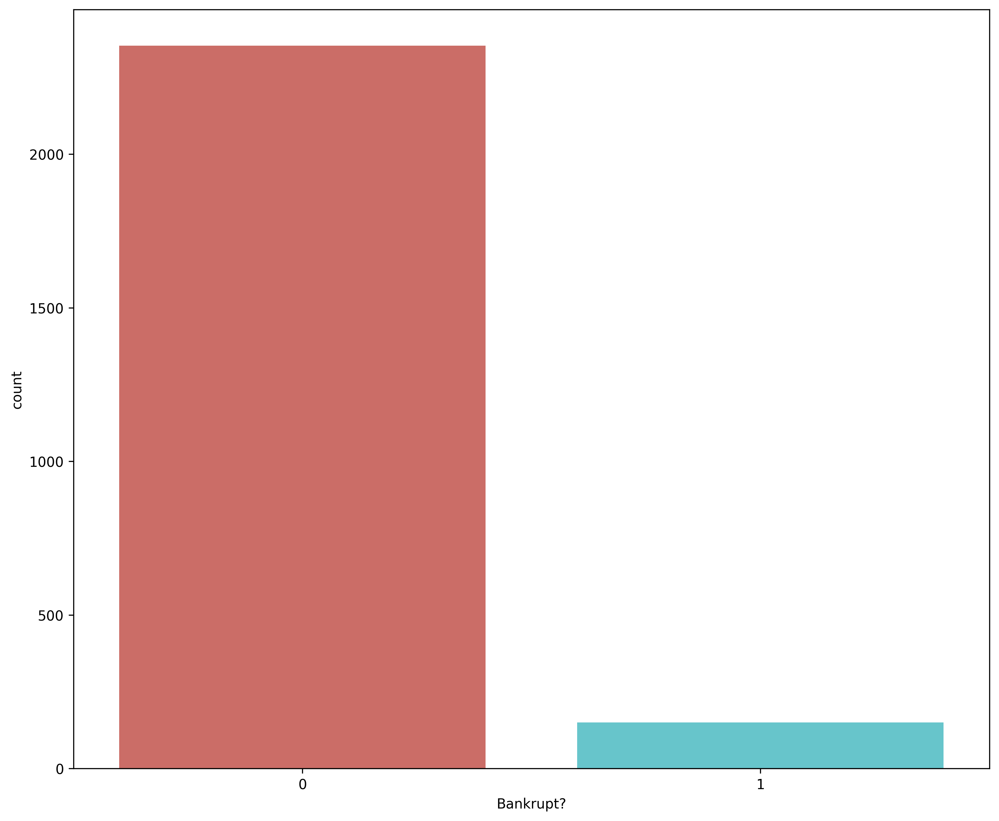

In [ ]:
sns.countplot(x = 'Bankrupt?', data = df2, palette = 'hls')

Outlier Detection

<Axes: >

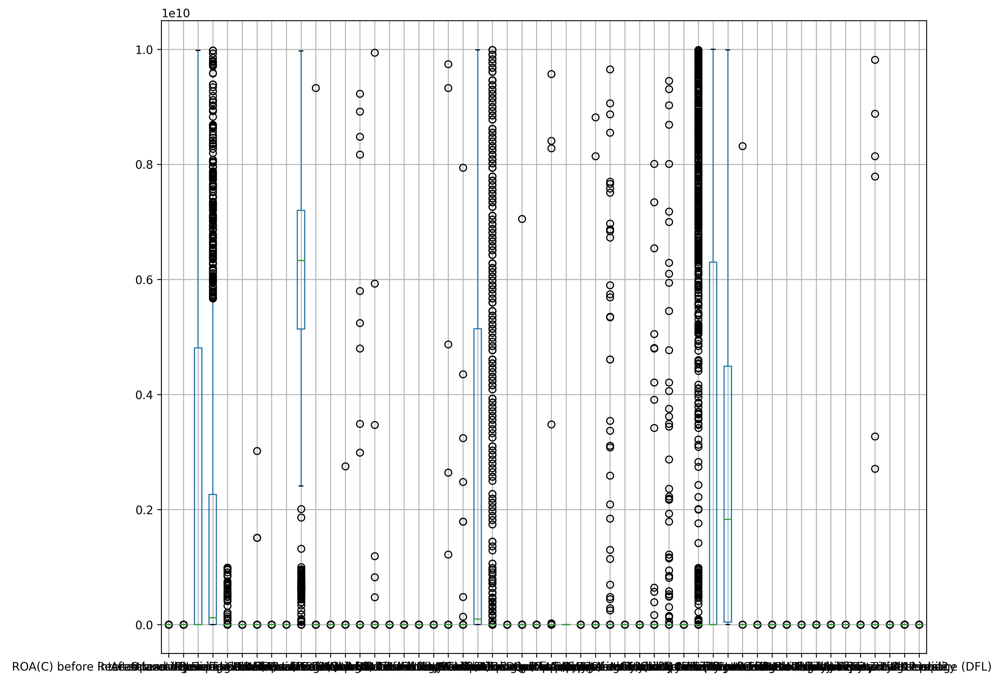

In [ ]:
df2.boxplot()

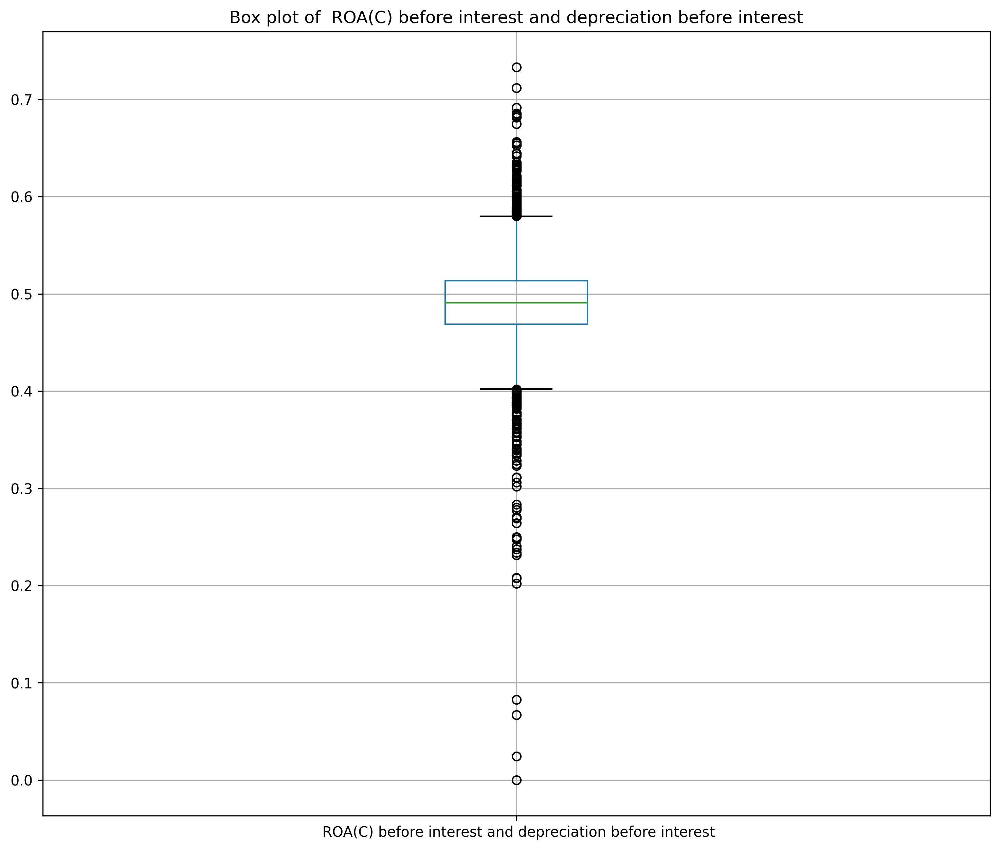

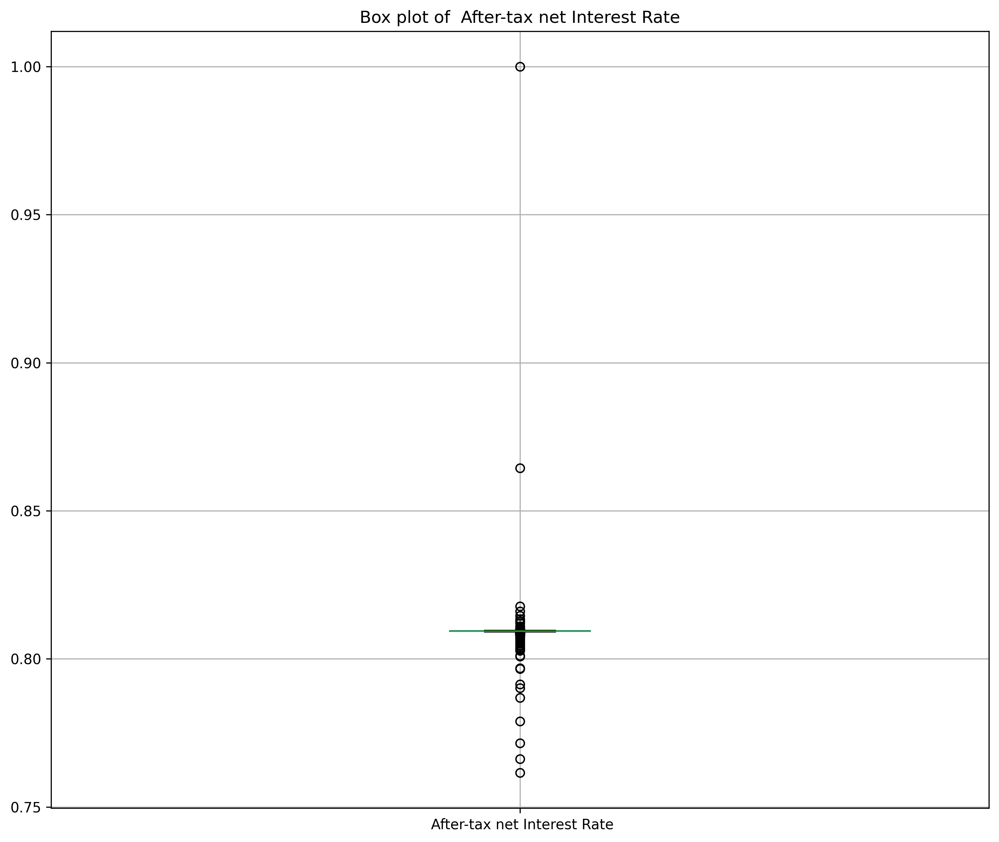

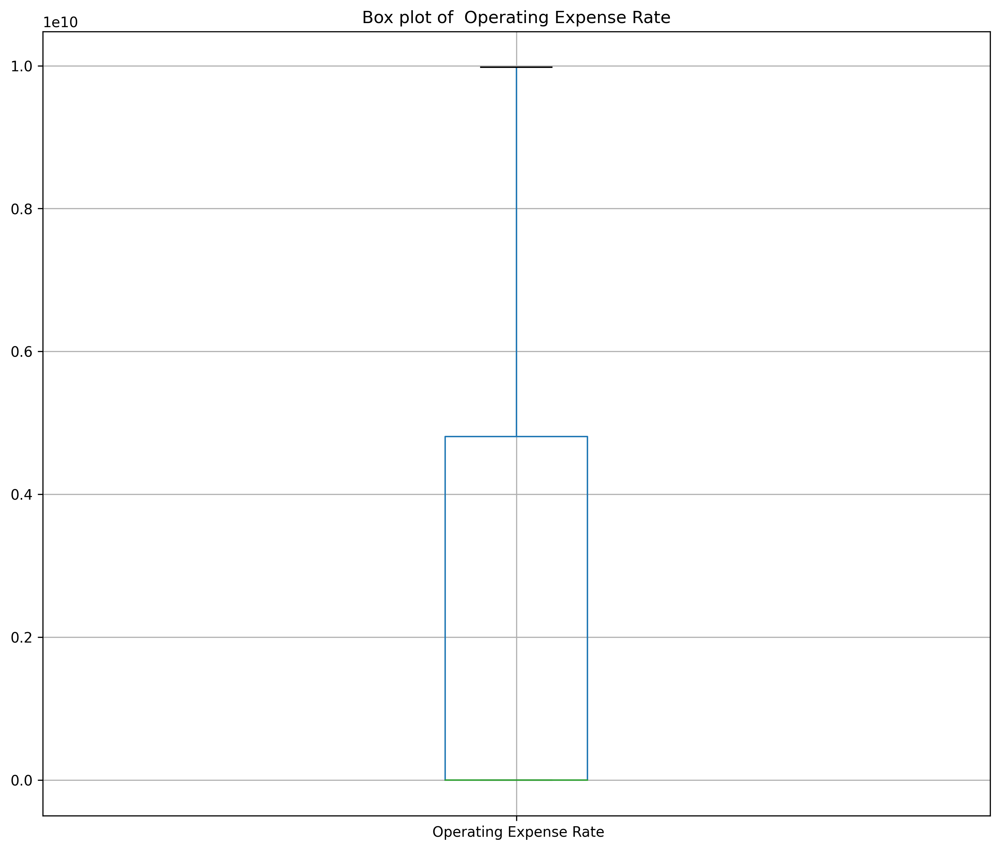

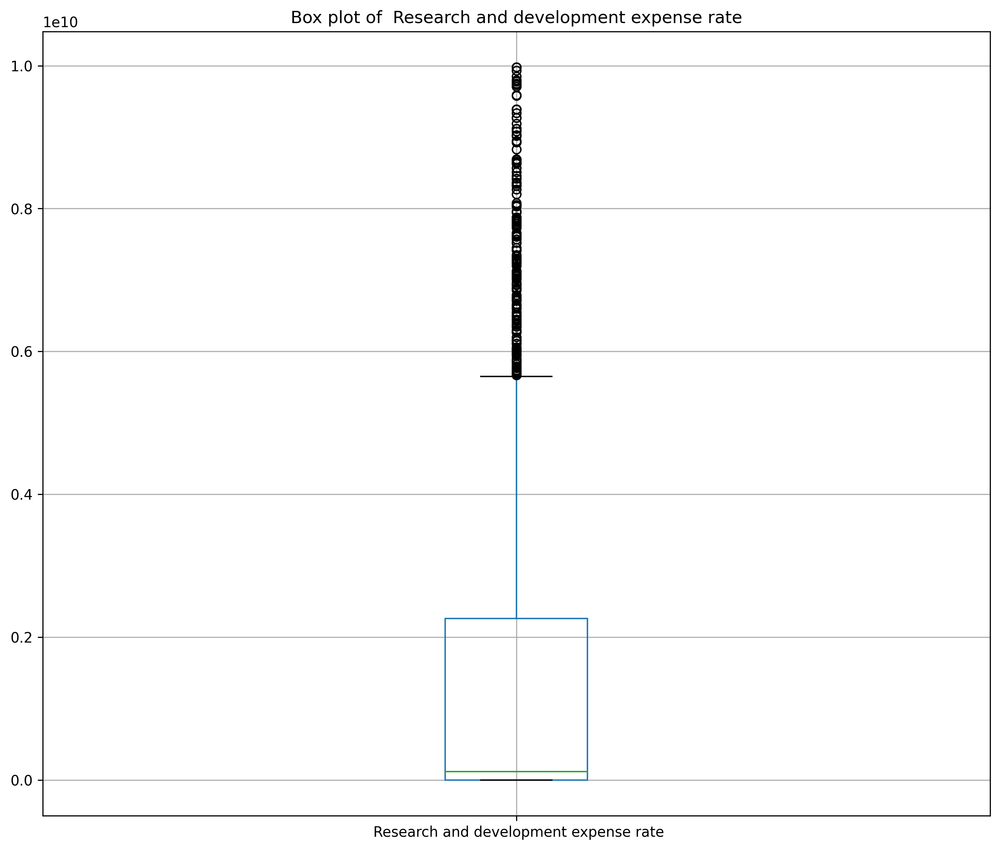

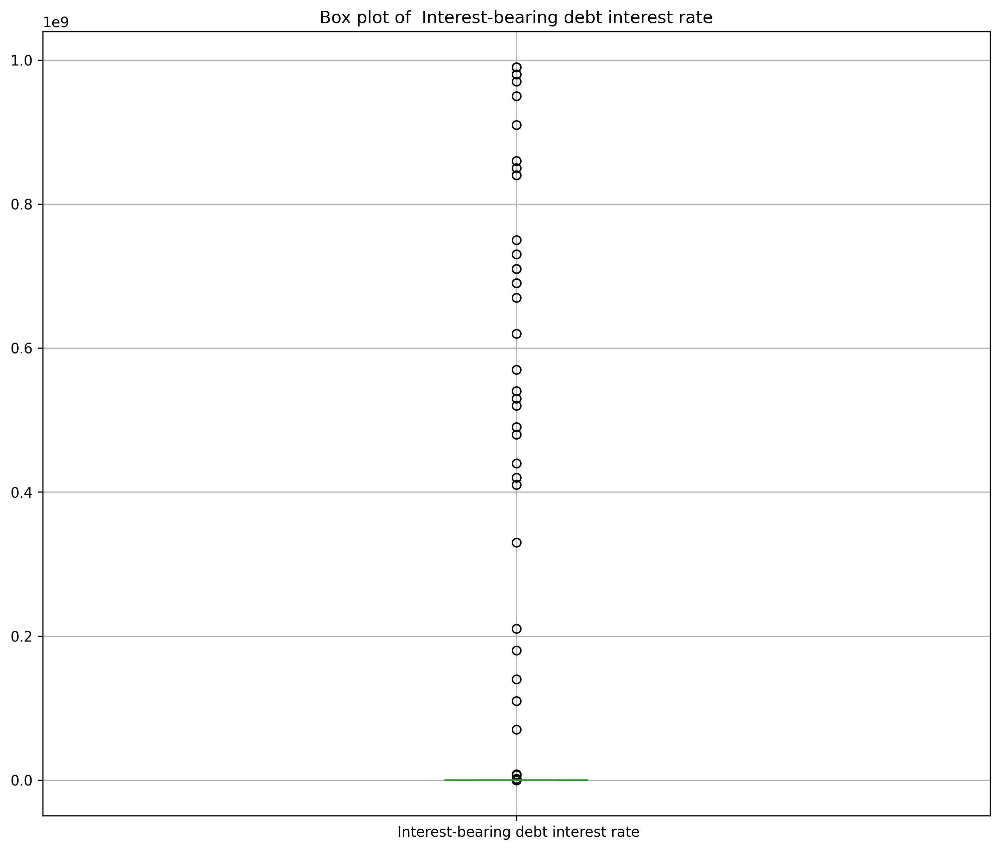

...

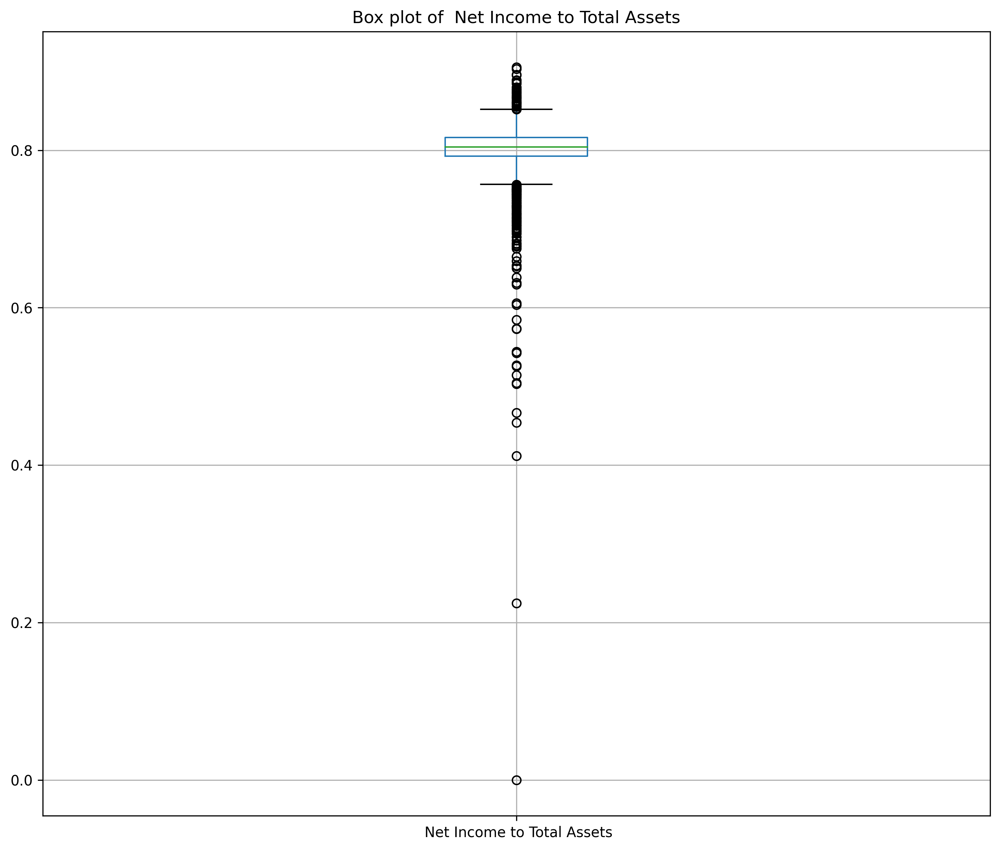

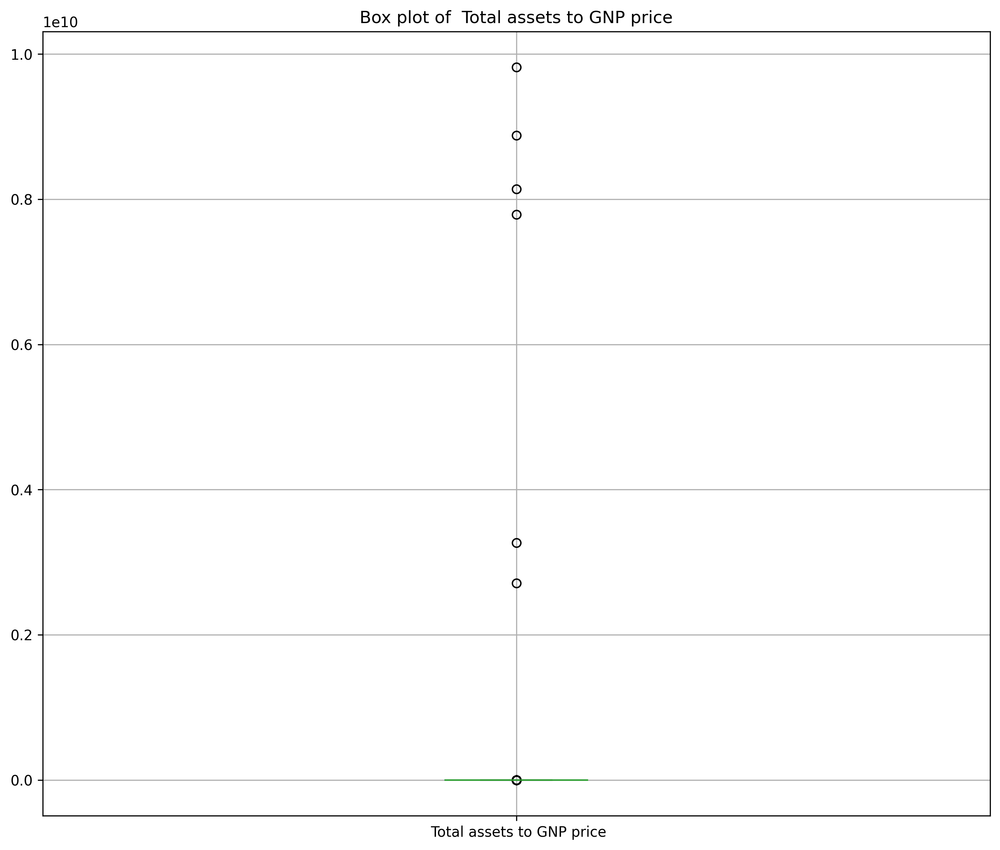

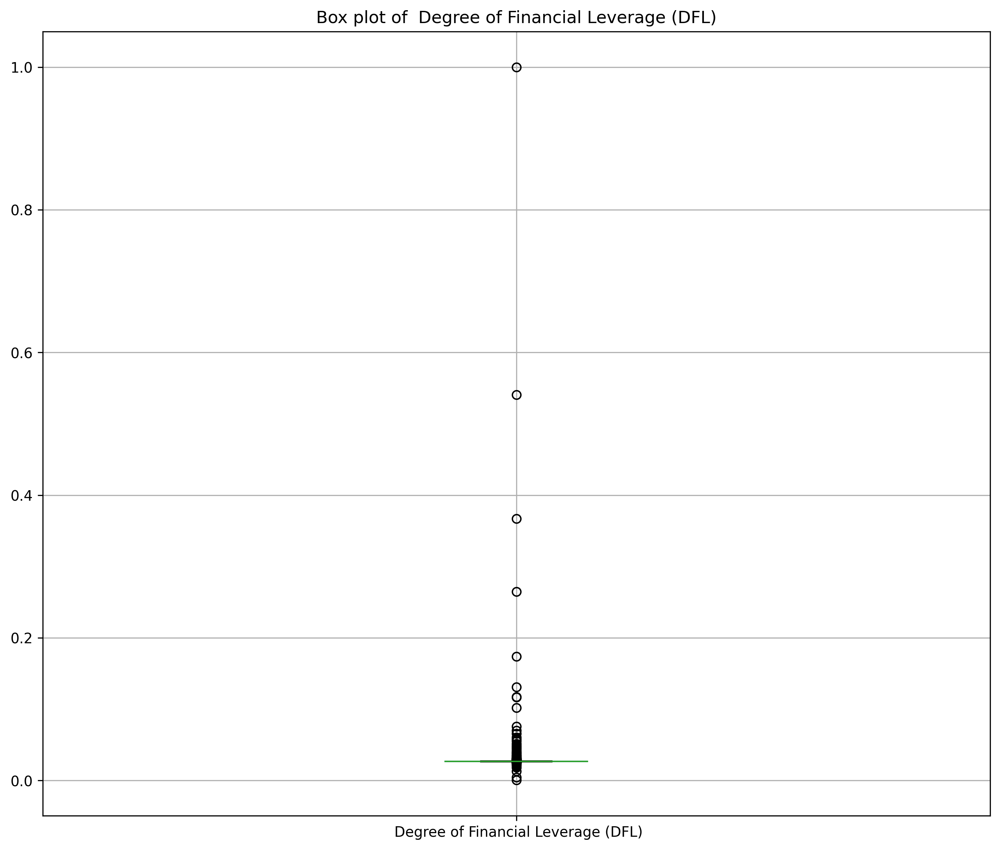

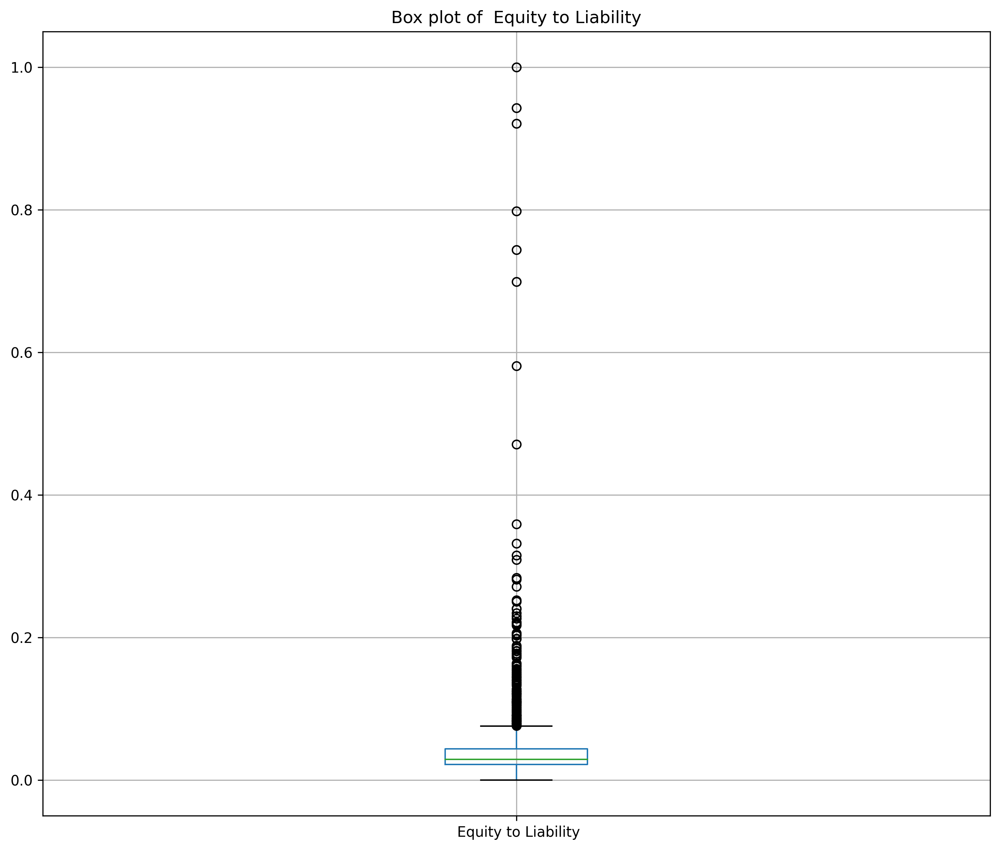

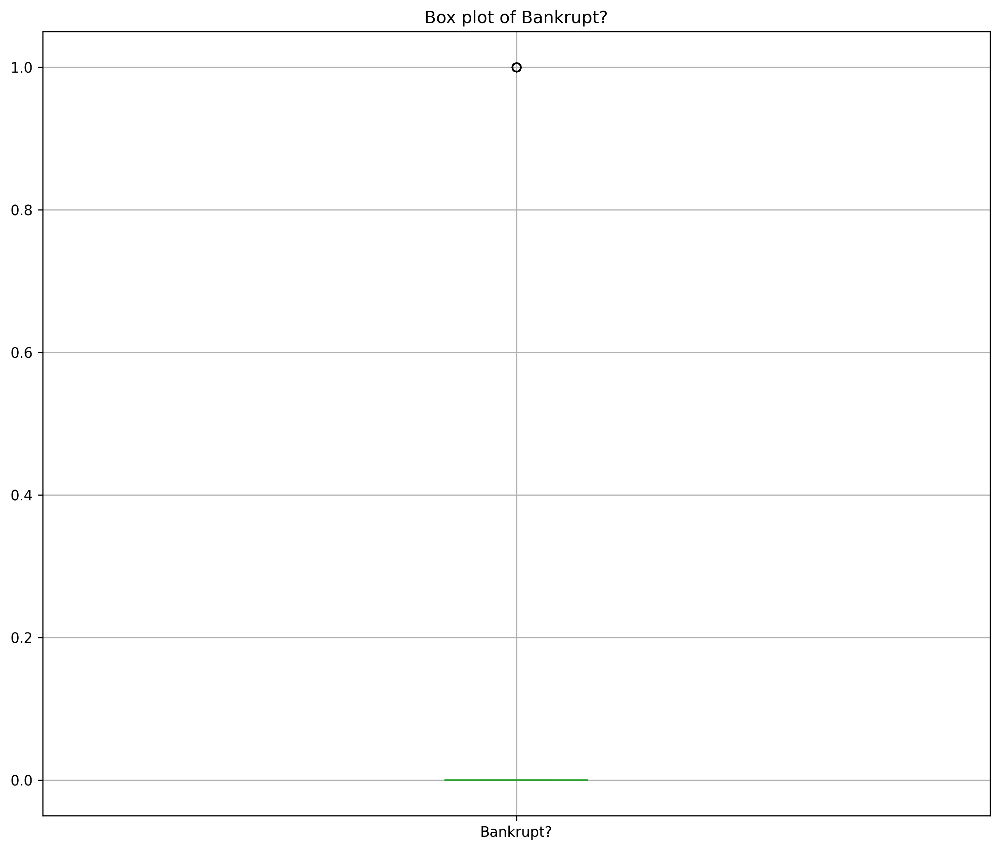

In [ ]:
for column in df2.select_dtypes(include=[np.number]).columns:
    plt.figure()
    df2.boxplot([column])
    plt.title(f'Box plot of {column}')
    plt.show()


In [ ]:
# we dont have outlier in Operating Expense Rate,itr,current asset/toal assets,cash trunover rate

Remove Outliers by using IQR Method

In [ ]:
# Define a function to remove outliers using IQR
def remove_outliers_iqr(df2, factor=1.5):
    df_no_outliers = df2.copy()
    numeric_columns = df2.select_dtypes(include=[np.number]).columns

    for col in numeric_columns:
        Q1 = df2[col].quantile(0.25)
        Q3 = df2[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - factor * IQR
        upper_bound = Q3 + factor * IQR
        df_no_outliers = df_no_outliers[(df_no_outliers[col] >= lower_bound) & (df_no_outliers[col] <= upper_bound)]

    return df_no_outliers



In [ ]:
# Remove outliers using IQR method
df_no_outliers_iqr = remove_outliers_iqr(df, factor=1.5)
print(f"Original data shape: {df2.shape}")
print(f"Data shape after removing outliers (IQR): {df_no_outliers_iqr.shape}")

Original data shape: (2477, 52)
Data shape after removing outliers (IQR): (142, 96)


<Axes: >

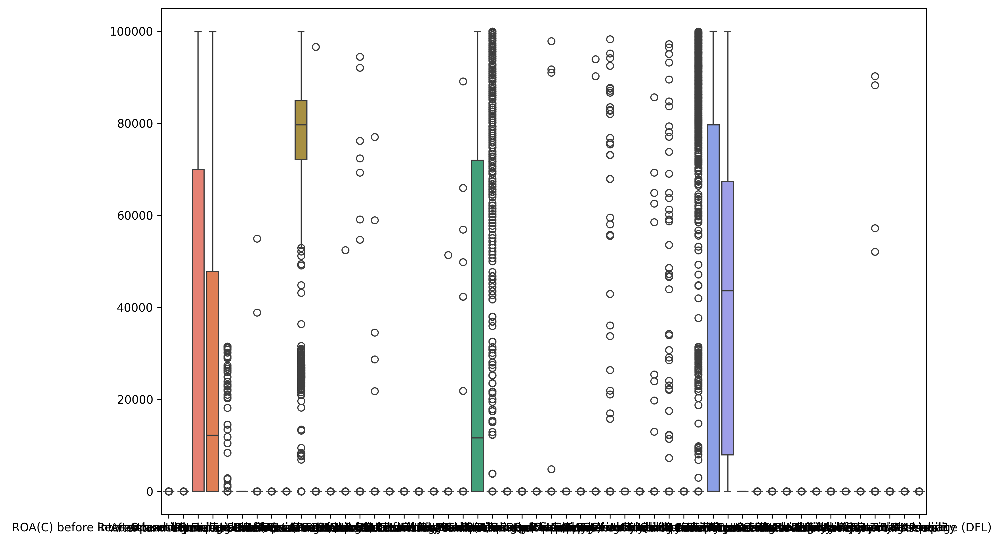

In [ ]:
# we use sqrt() to see more clearly despite the outliers

plt.figure(figsize=(12,8))
sns.boxplot(data=np.sqrt(df2))

/usr/local/lib/python3.10/dist-packages/pandas/core/internals/blocks.py:329: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)


<Axes: >

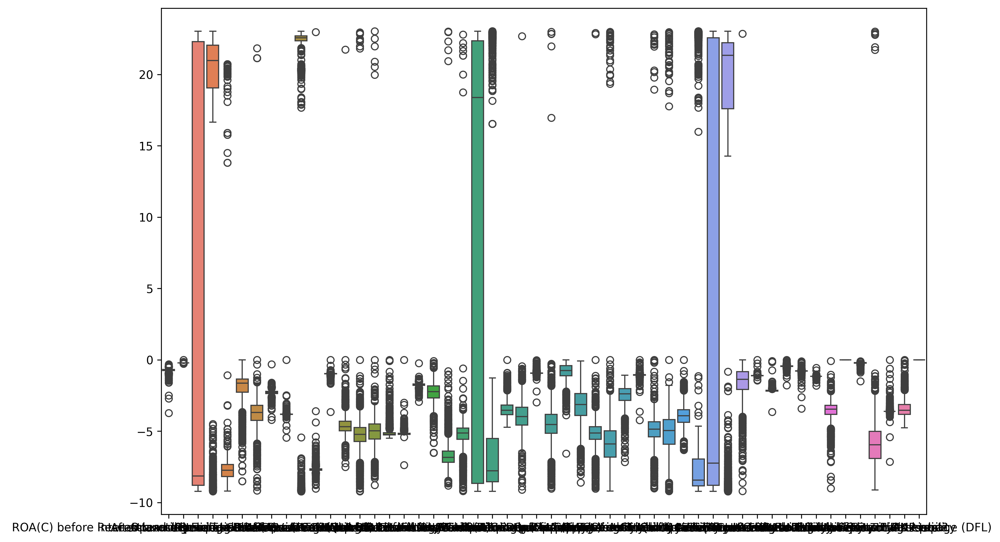

In [ ]:
plt.figure(figsize=(12,8))
sns.boxplot(data=np.log(df2))

LOF is another effective method for identifying anomalies based on the local density of data points.

In [ ]:
from sklearn.neighbors import LocalOutlierFactor

# Initialize the Local Outlier Factor
lof = LocalOutlierFactor(n_neighbors=20, contamination=0.01)

# Fit and predict outliers
outliers = lof.fit_predict(X_numeric)
df2['outlier'] = outliers

# Remove outliers
df_no_outliers_lof = df2[df2['outlier'] == 1].drop(columns=['outlier'])
print(f"Data shape after removing outliers (LOF): {df_no_outliers_lof.shape}")


df2 = df_no_outliers_lof.copy()

Data shape after removing outliers (LOF): (2477, 52)


<ipython-input-33-44a574ea9935>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x = 'Bankrupt?', data = df2, palette = 'hls')


<Axes: xlabel='Bankrupt?', ylabel='count'>

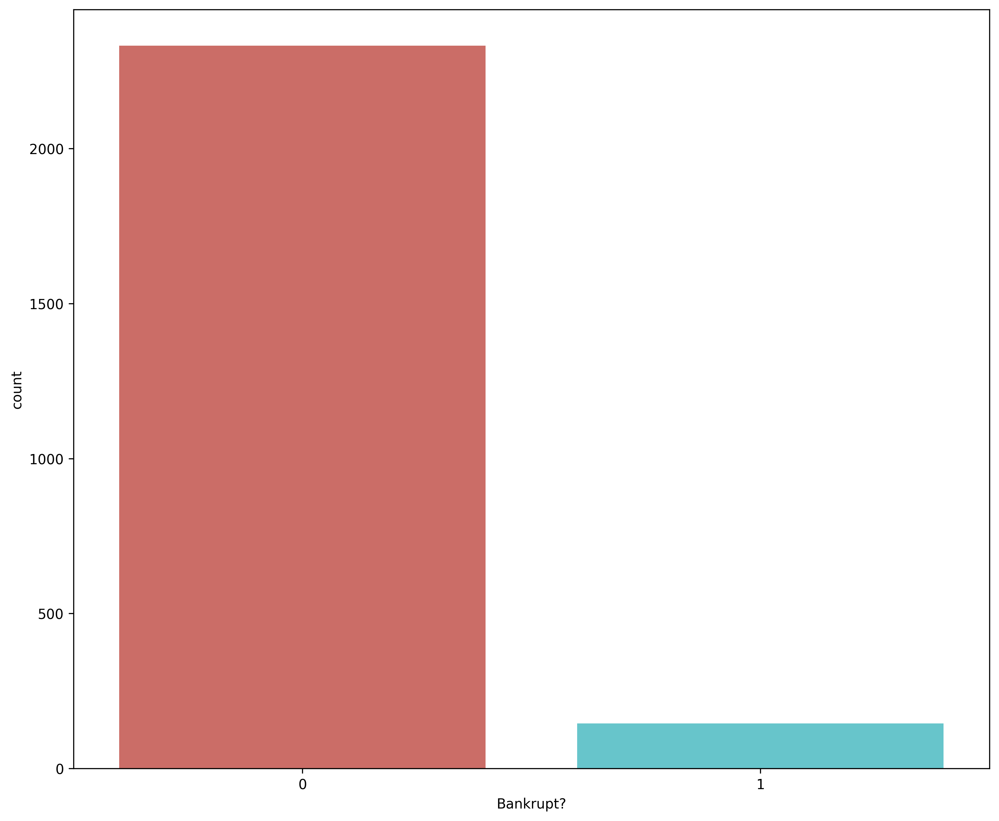

In [ ]:
sns.countplot(x = 'Bankrupt?', data = df2, palette = 'hls')

Sandardizing data

In [ ]:
standard_scaler = StandardScaler()
std_df = standard_scaler.fit_transform(df2)
std_df.shape

(2477, 52)

In [ ]:
std_df

array([[-2.25021585, -0.33895102, -0.6740377 , ..., -0.0715231 ,
        -0.47369324,  4.01033149],
       [-0.47422676,  0.04297657, -0.6740377 , ...,  9.74837566,
        -0.39165061,  4.01033149],
       [-1.19866768, -0.66683798, -0.6740377 , ..., -0.07341757,
        -0.47359132,  4.01033149],
       ...,
       [ 2.31357712,  3.22135489, -0.6740377 , ..., -0.06264374,
        -0.12560538, -0.24935595],
       [ 0.03399072,  0.24638792,  0.57264129, ..., -0.06359389,
         1.35427313, -0.24935595],
       [ 0.22618933,  0.12363271, -0.6740377 , ..., -0.05984273,
        -0.78605447, -0.24935595]])

In [ ]:

# Separate features and target variable
x = df2.drop(columns=['Bankrupt?'])
y = df2['Bankrupt?']



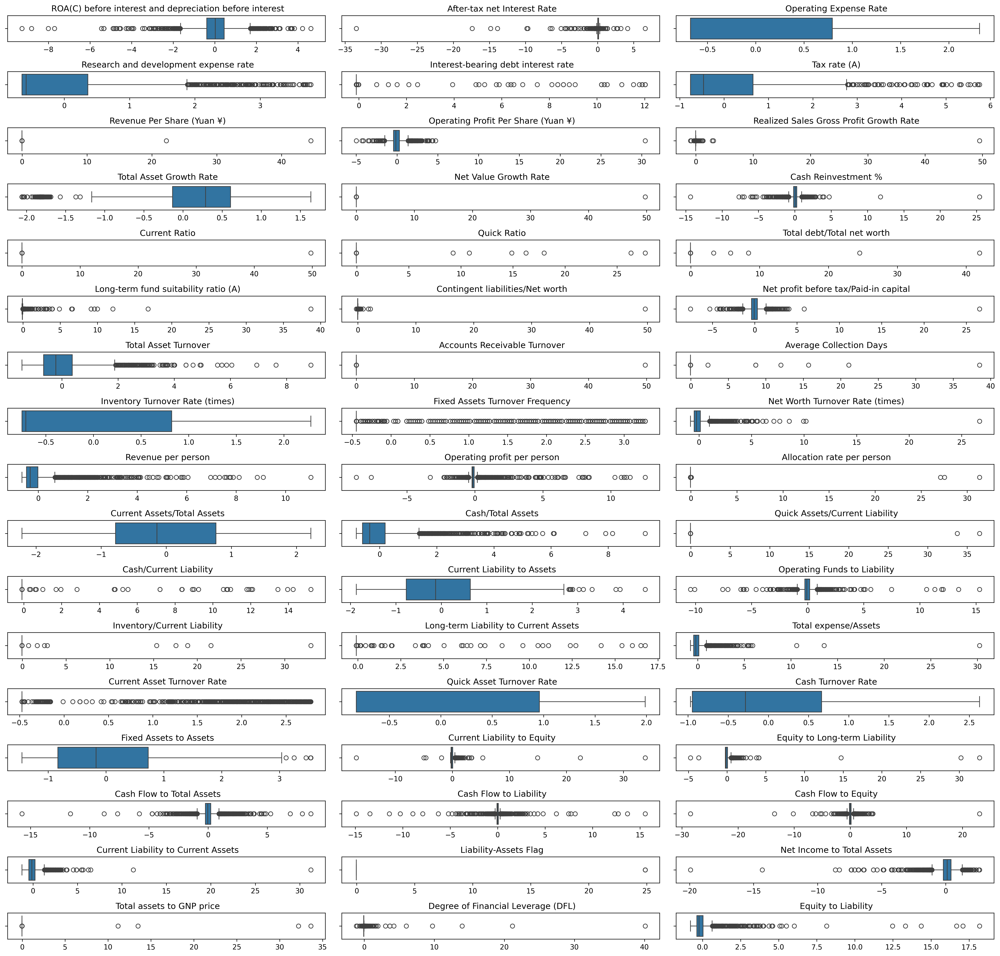

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Visualize the distribution of each numeric feature using box plots
plt.figure(figsize=(20,20))
for i, col in enumerate(x.columns, 1):
    plt.subplot(len(x.columns) // 3 + 1, 3, i)
    sns.boxplot(x=std_df[:, i-1])
    plt.title(col)

plt.tight_layout()
plt.show()


Feature Selection

In [ ]:
from sklearn.feature_selection import SelectKBest, f_classif
# Standardize the features
standard_scaler = StandardScaler()
std_x = standard_scaler.fit_transform(x) # Standardize x, not df2

# Select the top k features
k = 10  # Choose an appropriate number of features
selector = SelectKBest(score_func=f_classif, k=k)
X_selected = selector.fit_transform(std_x, y)

# Get selected feature names
selected_features = x.columns[selector.get_support()]
print("Selected features:", selected_features)


Selected features: Index([' ROA(C) before interest and depreciation before interest',
       ' Tax rate (A)', ' Operating Profit Per Share (Yuan ¥)',
       ' Net profit before tax/Paid-in capital',
       ' Current Liability to Assets', ' Current Liability to Equity',
       ' Equity to Long-term Liability',
       ' Current Liability to Current Assets', ' Liability-Assets Flag',
       ' Net Income to Total Assets'],
      dtype='object')


In [ ]:

# Standardize the selected features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_selected)

In [ ]:
from imblearn.over_sampling import SMOTE
# SMOTE for handling class imbalance
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_scaled, y)

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)


Model Building

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
import lightgbm as lgb
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import classification_report, roc_auc_score, roc_curve,accuracy_score
import matplotlib.pyplot as plt

# Initialize models
models = {
    "Logistic Regression": LogisticRegression(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "SVM": SVC(probability=True),
    "Gradient Boosting": GradientBoostingClassifier(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Naive Bayes": GaussianNB(),
    "LightGBM": lgb.LGBMClassifier()

}


In [ ]:
# Lists to store model names and accuracy scores
model_names = []
accuracy_scores = []

Logistic Regression accuracy: 0.87
              precision    recall  f1-score   support

           0       0.87      0.89      0.88       493
           1       0.87      0.86      0.86       440

    accuracy                           0.87       933
   macro avg       0.87      0.87      0.87       933
weighted avg       0.87      0.87      0.87       933



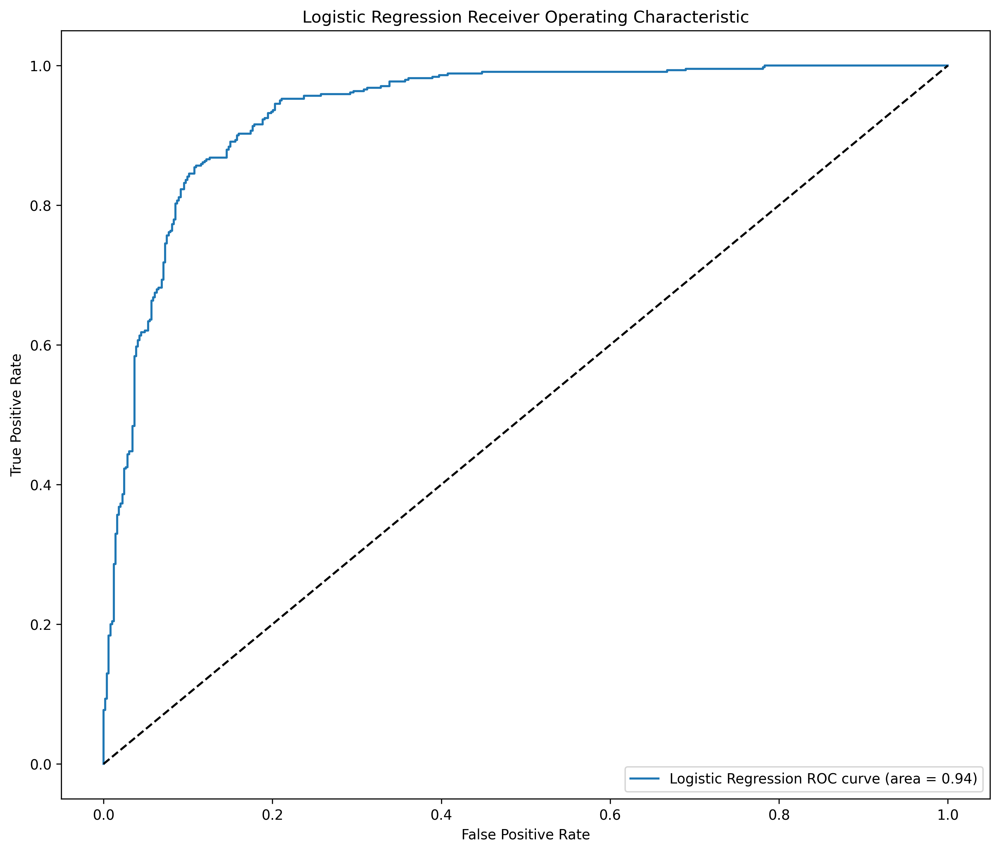

Decision Tree accuracy: 0.91
              precision    recall  f1-score   support

           0       0.94      0.89      0.92       493
           1       0.89      0.93      0.91       440

    accuracy                           0.91       933
   macro avg       0.91      0.91      0.91       933
weighted avg       0.91      0.91      0.91       933



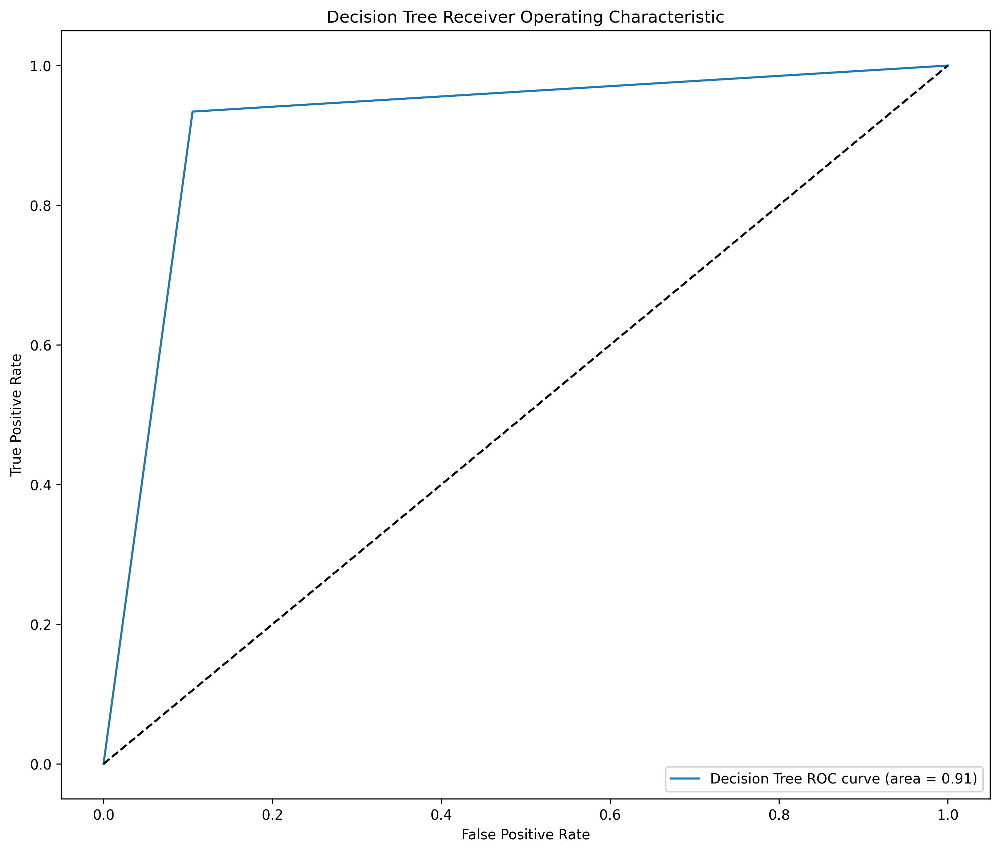

Random Forest accuracy: 0.95
              precision    recall  f1-score   support

           0       0.97      0.94      0.96       493
           1       0.93      0.97      0.95       440

    accuracy                           0.95       933
   macro avg       0.95      0.96      0.95       933
weighted avg       0.96      0.95      0.96       933



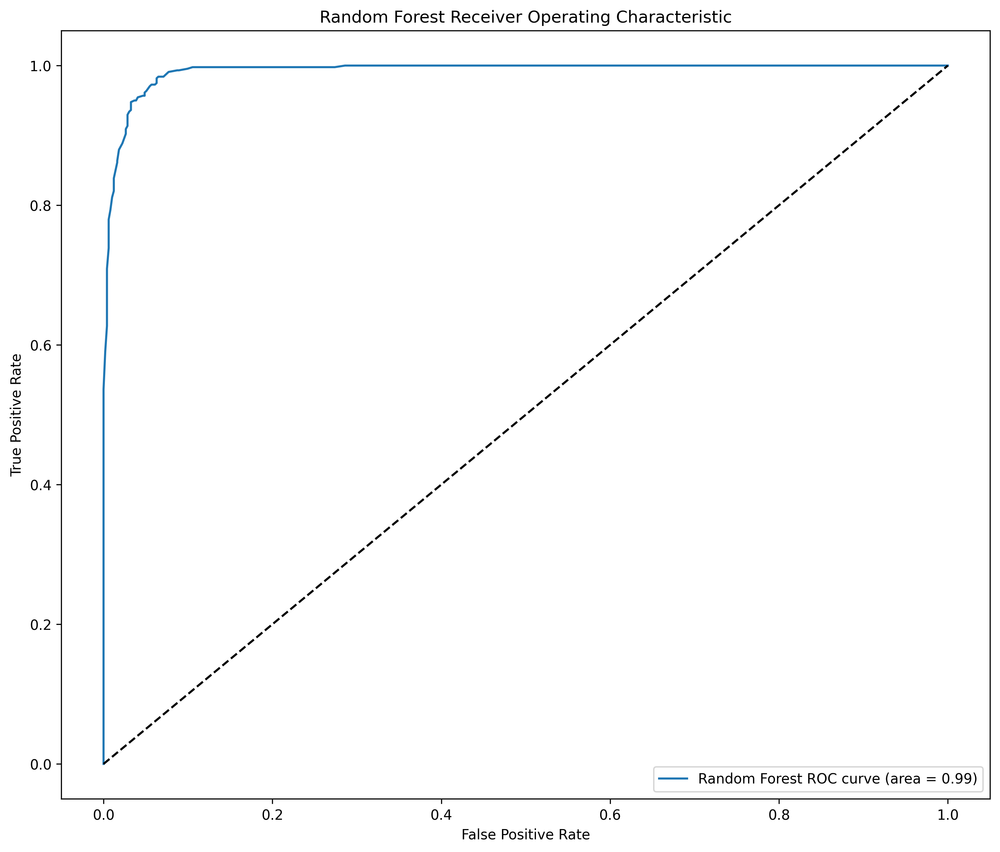

SVM accuracy: 0.87
              precision    recall  f1-score   support

           0       0.89      0.87      0.88       493
           1       0.85      0.88      0.86       440

    accuracy                           0.87       933
   macro avg       0.87      0.87      0.87       933
weighted avg       0.87      0.87      0.87       933



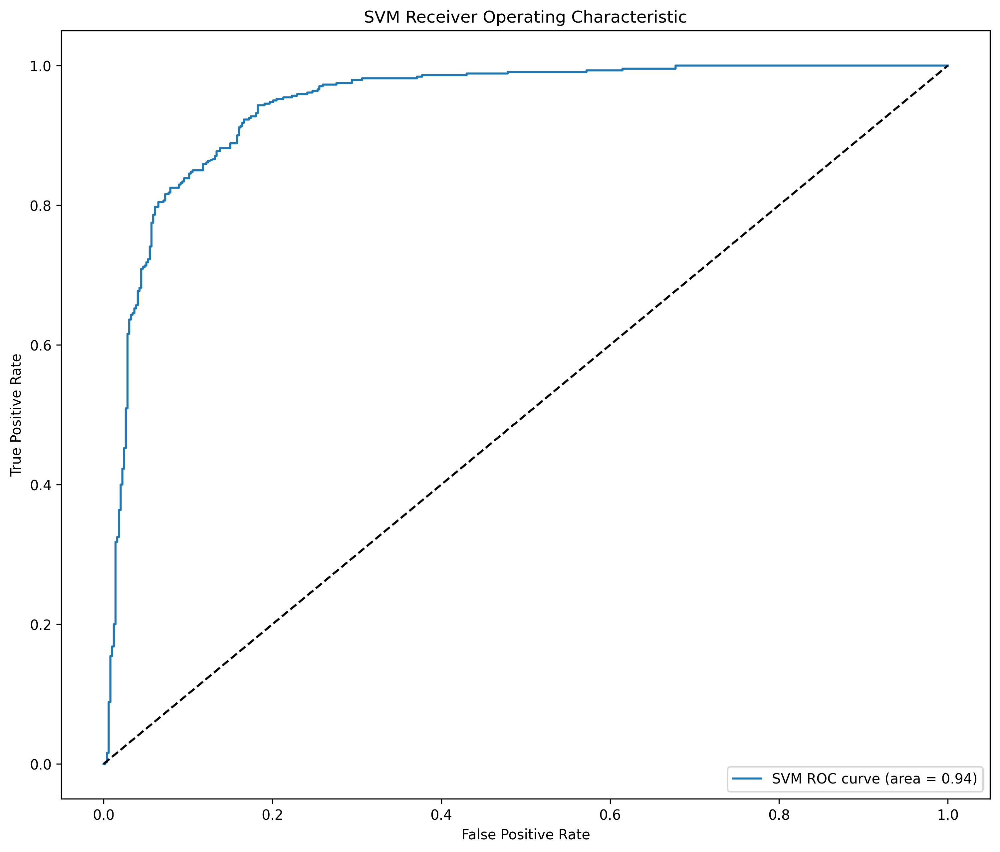

Gradient Boosting accuracy: 0.92
              precision    recall  f1-score   support

           0       0.95      0.91      0.93       493
           1       0.90      0.94      0.92       440

    accuracy                           0.92       933
   macro avg       0.92      0.92      0.92       933
weighted avg       0.92      0.92      0.92       933



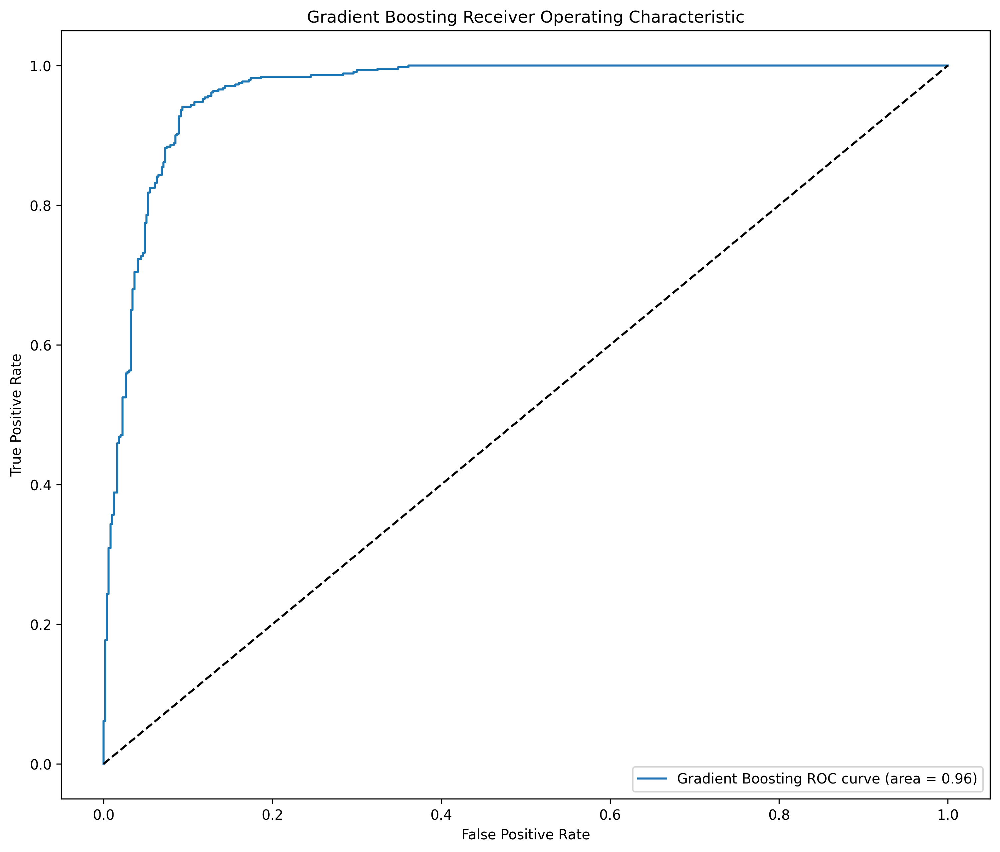

K-Nearest Neighbors accuracy: 0.92
              precision    recall  f1-score   support

           0       0.99      0.86      0.92       493
           1       0.87      0.99      0.92       440

    accuracy                           0.92       933
   macro avg       0.93      0.93      0.92       933
weighted avg       0.93      0.92      0.92       933



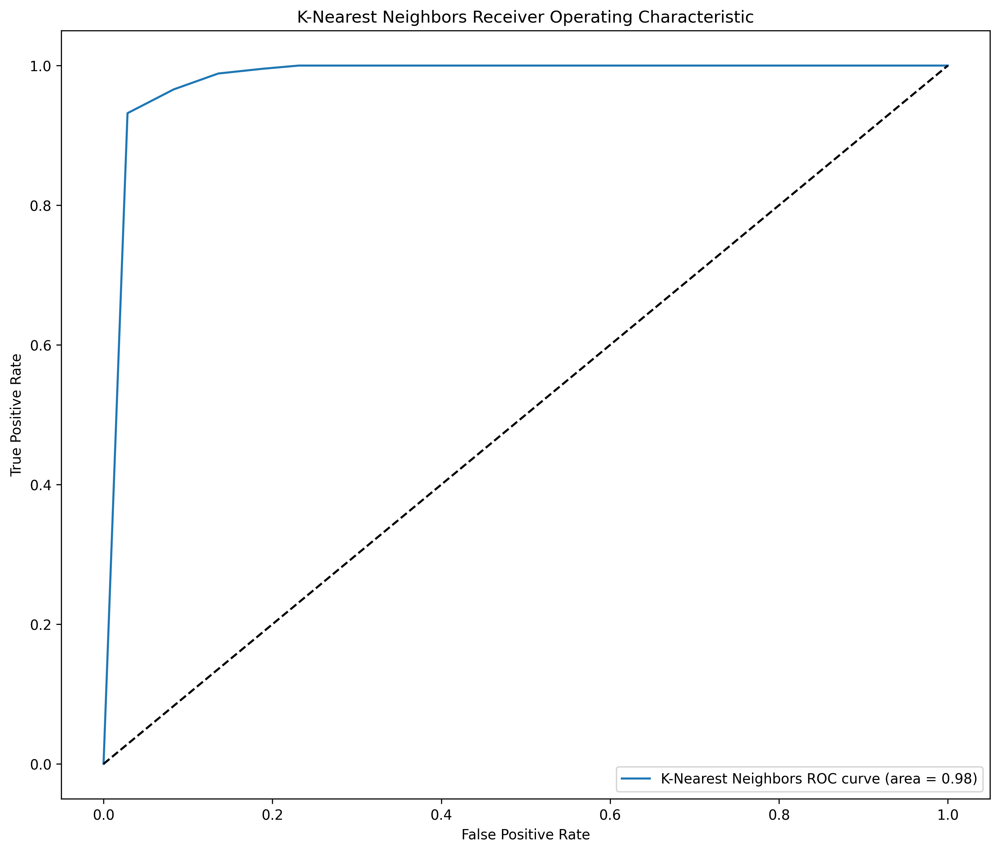

Naive Bayes accuracy: 0.58
              precision    recall  f1-score   support

           0       0.56      0.99      0.71       493
           1       0.91      0.12      0.21       440

    accuracy                           0.58       933
   macro avg       0.73      0.55      0.46       933
weighted avg       0.72      0.58      0.48       933



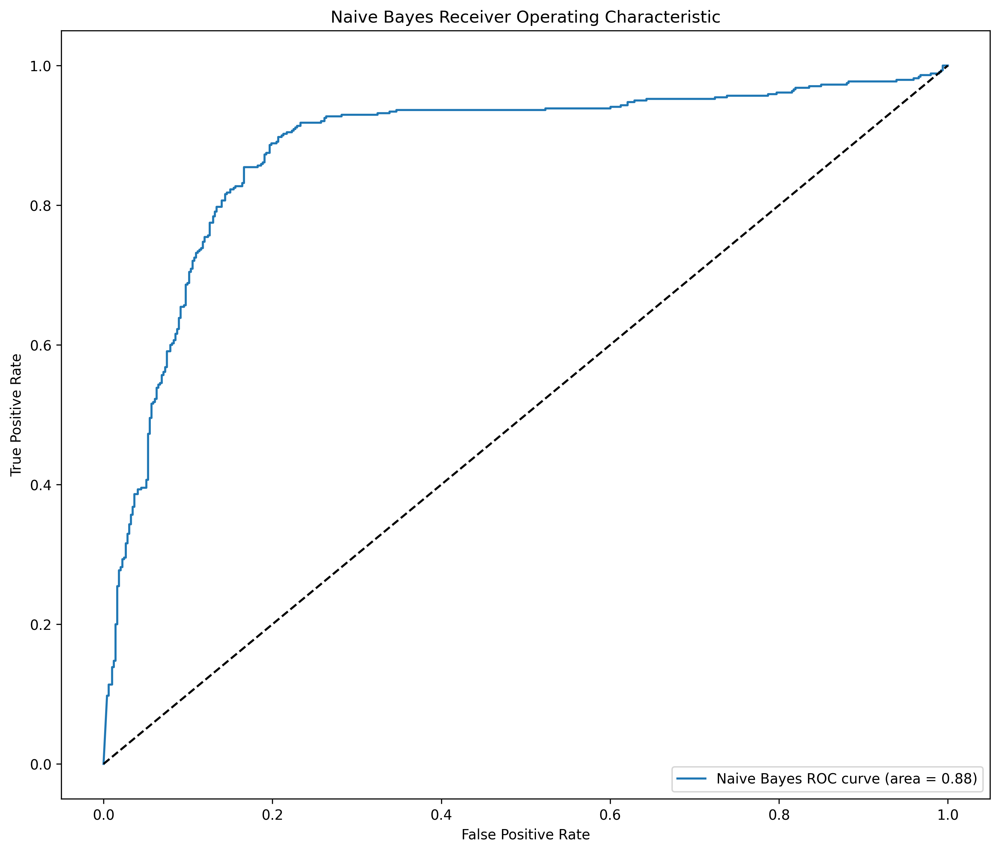

[LightGBM] [Info] Number of positive: 1892, number of negative: 1839
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000592 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2304
[LightGBM] [Info] Number of data points in the train set: 3731, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.507103 -> initscore=0.028413
[LightGBM] [Info] Start training from score 0.028413
LightGBM accuracy: 0.95
              precision    recall  f1-score   support

           0       0.98      0.93      0.96       493
           1       0.93      0.98      0.95       440

    accuracy                           0.95       933
   macro avg       0.95      0.96      0.95       933
weighted avg       0.96      0.95      0.96       933



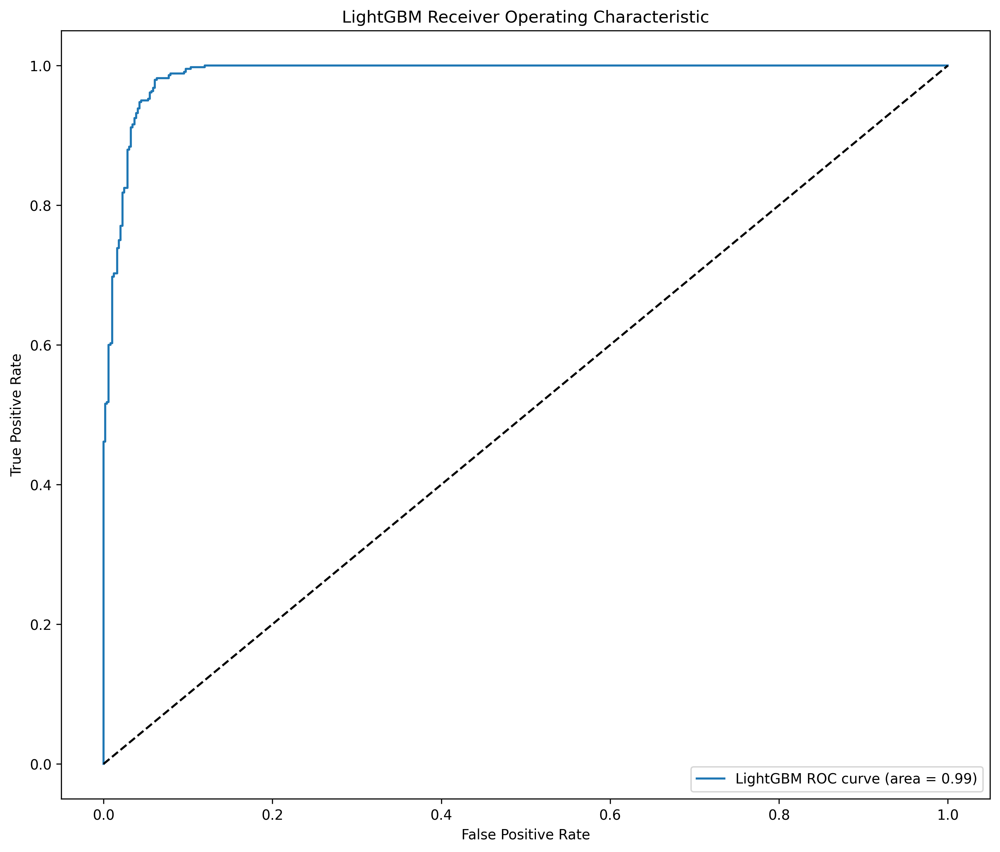

In [ ]:

# Train and evaluate models
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else model.decision_function(X_test)
    accuracy = model.score(X_test, y_test)
    model_names.append(name)
    accuracy_scores.append(accuracy)
    print(f"{name} accuracy: {model.score(X_test, y_test):.2f}")
    print(classification_report(y_test, y_pred))
    roc_auc = roc_auc_score(y_test, y_proba)
    fpr, tpr, _ = roc_curve(y_test, y_proba)
    plt.figure()
    plt.plot(fpr, tpr, label=f'{name} ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'{name} Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()


Hypertunig Parameters

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid_rf = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]
}

grid_search_rf = GridSearchCV(estimator=RandomForestClassifier(), param_grid=param_grid_rf, cv=3, n_jobs=-1, verbose=2)
grid_search_rf.fit(X_train, y_train)
print(grid_search_rf.best_params_)


Fitting 3 folds for each of 24 candidates, totalling 72 fits
{'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


In [ ]:
param_grid_lgb = {
    'num_leaves': [31, 50, 100],
    'learning_rate': [0.01, 0.05, 0.1],
    'n_estimators': [100, 200, 300]
}

grid_search_lgb = GridSearchCV(estimator=lgb.LGBMClassifier(), param_grid=param_grid_lgb, cv=3, n_jobs=-1, verbose=2)
grid_search_lgb.fit(X_train, y_train)
print("Best parameters for LightGBM:", grid_search_lgb.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
[LightGBM] [Info] Number of positive: 1892, number of negative: 1839
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000667 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2304
[LightGBM] [Info] Number of data points in the train set: 3731, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.507103 -> initscore=0.028413
[LightGBM] [Info] Start training from score 0.028413
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Best parameters for LightGBM: {'learning_rate': 0.05, 'n_estimators': 300, 'num_leaves': 100}


 Ensembling Methods

In [ ]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier

# Ensemble model using VotingClassifier
voting_clf = VotingClassifier(estimators=[
    ('lr', LogisticRegression()),
    ('dt', DecisionTreeClassifier()),
    ('rf', RandomForestClassifier(**grid_search_rf.best_params_)),
    ('svm', SVC(probability=True)),
    ('gb', GradientBoostingClassifier()),
    ('knn', KNeighborsClassifier()),
    ('nb', GaussianNB()),
    ('lgb', lgb.LGBMClassifier(**grid_search_lgb.best_params_)),

], voting='soft')



In [ ]:
voting_clf.fit(X_train, y_train)
y_pred = voting_clf.predict(X_test)
y_proba = voting_clf.predict_proba(X_test)[:, 1]
print(f"Voting Classifier accuracy: {accuracy_score(y_test, y_pred):.2f}")
print(classification_report(y_test, y_pred))

[LightGBM] [Info] Number of positive: 1892, number of negative: 1839
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000703 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2304
[LightGBM] [Info] Number of data points in the train set: 3731, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.507103 -> initscore=0.028413
[LightGBM] [Info] Start training from score 0.028413
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Voting Classifier accuracy: 0.95
              precision    recall  f1-score   support

           0       0.97      0.94      0.95       493
           1       0.93      0.96      0.95       440

    accuracy                           0.95       933
   macro avg       0.95      0.95      0.95       933
weighted avg       0.95      0.95      0.95       933



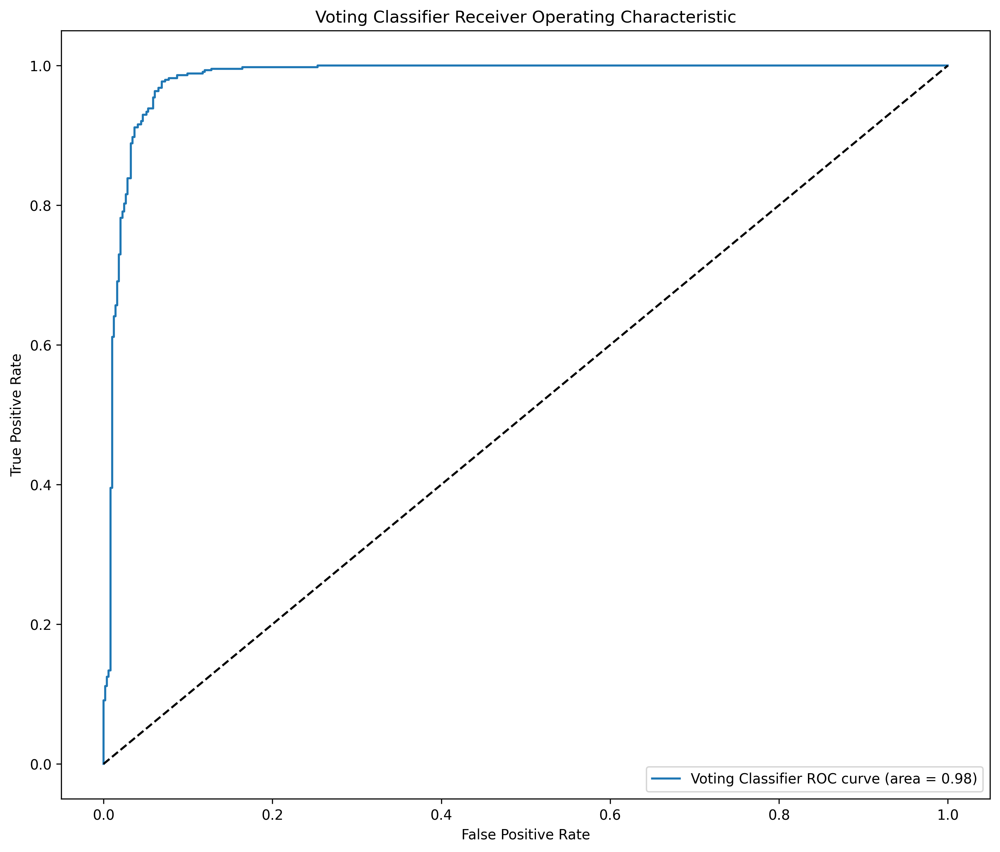

In [ ]:
roc_auc = roc_auc_score(y_test, y_proba)
fpr, tpr, _ = roc_curve(y_test, y_proba)
plt.figure()
plt.plot(fpr, tpr, label=f'Voting Classifier ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Voting Classifier Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()

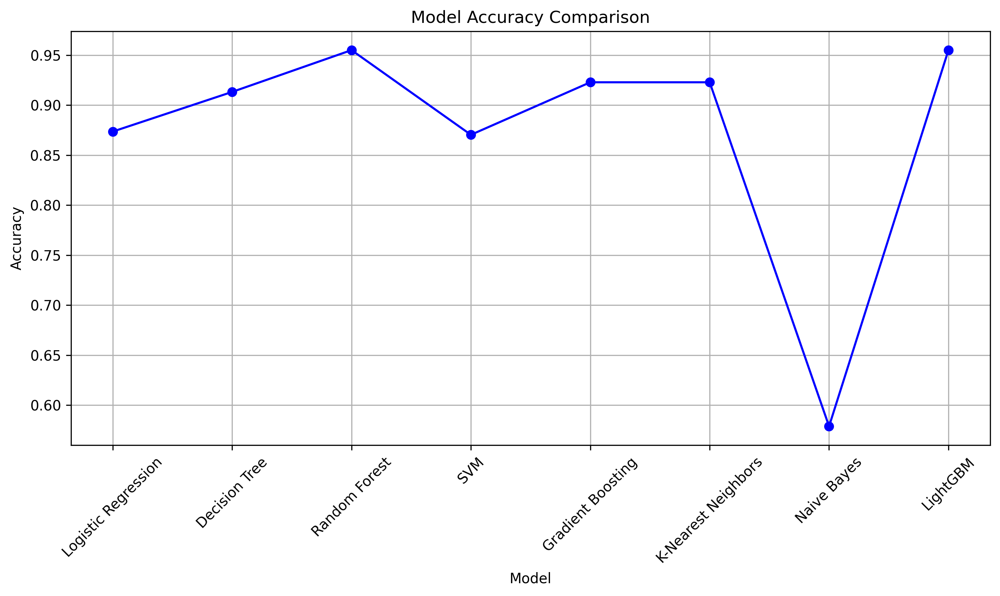

In [ ]:
# Plot the accuracy scores for all models
plt.figure(figsize=(10, 6))
plt.plot(model_names, accuracy_scores, marker='o', linestyle='-', color='b')
plt.title('Model Accuracy Comparison')
plt.xlabel('Model')
plt.ylabel('Accuracy')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

Model Validation

In [ ]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(voting_clf, X_train, y_train, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cv_scores)
print("Mean Cross-Validation Score:", cv_scores.mean())


[LightGBM] [Info] Number of positive: 1513, number of negative: 1471
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000576 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2302
[LightGBM] [Info] Number of data points in the train set: 2984, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.507038 -> initscore=0.028152
[LightGBM] [Info] Start training from score 0.028152
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 1513, number of negative: 1472
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000541 seconds.
You can set `force_col_wise=true` to r

In [ ]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='accuracy')
print("Cross-Validation Scores:", cv_scores)
print("Mean Cross-Validation Score:", cv_scores.mean())

[LightGBM] [Info] Number of positive: 1513, number of negative: 1471
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000546 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2302
[LightGBM] [Info] Number of data points in the train set: 2984, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.507038 -> initscore=0.028152
[LightGBM] [Info] Start training from score 0.028152
[LightGBM] [Info] Number of positive: 1513, number of negative: 1472
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000583 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2302
[LightGBM] [Info] Number of data points in the train set: 2985, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.506868 -> initscore=0.027472
[LightGBM] [Info] Start training from score 0.027472
[LightGBM] [Info] Numb

Checking accuracy of dataset without removing outliers

In [ ]:
standard_scaler = StandardScaler()
std_df = standard_scaler.fit_transform(df)
std_df.shape

(2503, 96)

In [ ]:
std_df

array([[ 3.96063968e+00, -2.23012616e+00, -2.01271350e+00, ...,
        -6.13681311e-02,  1.99920048e-02, -4.69671427e-01],
       [ 3.96063968e+00, -4.67496287e-01, -1.03935492e-01, ...,
         2.51876719e-01,  1.99920048e-02, -3.89000199e-01],
       [ 3.96063968e+00, -1.18648787e+00, -7.61220639e-01, ...,
        -7.89632910e-02,  1.99920048e-02, -4.69571214e-01],
       ...,
       [-2.52484467e-01,  2.29933738e+00,  2.34785695e+00, ...,
         1.18911129e-03,  1.99920048e-02, -1.27402128e-01],
       [-2.52484467e-01,  3.68983165e-02,  1.59344233e-01, ...,
        -4.28962112e-03,  1.99920048e-02,  1.32773904e+00],
       [-2.52484467e-01,  2.27651185e-01,  1.60258399e-01, ...,
         1.60625552e-02, -5.00199960e+01, -7.76811289e-01]])

In [ ]:
X = df.drop(columns=['Bankrupt?'])
Y = df['Bankrupt?']


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(std_df, Y, test_size=0.2, random_state=42)

Logistic Regression accuracy: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       467
           1       1.00      1.00      1.00        34

    accuracy                           1.00       501
   macro avg       1.00      1.00      1.00       501
weighted avg       1.00      1.00      1.00       501



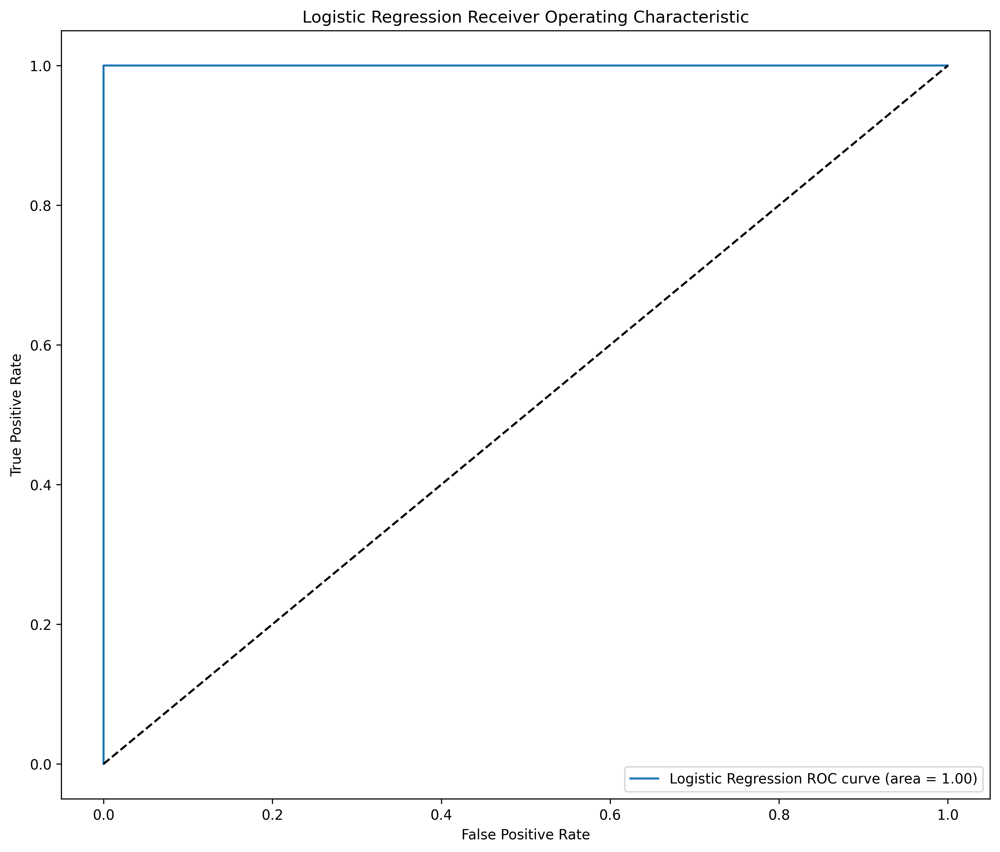

Decision Tree accuracy: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       467
           1       1.00      1.00      1.00        34

    accuracy                           1.00       501
   macro avg       1.00      1.00      1.00       501
weighted avg       1.00      1.00      1.00       501



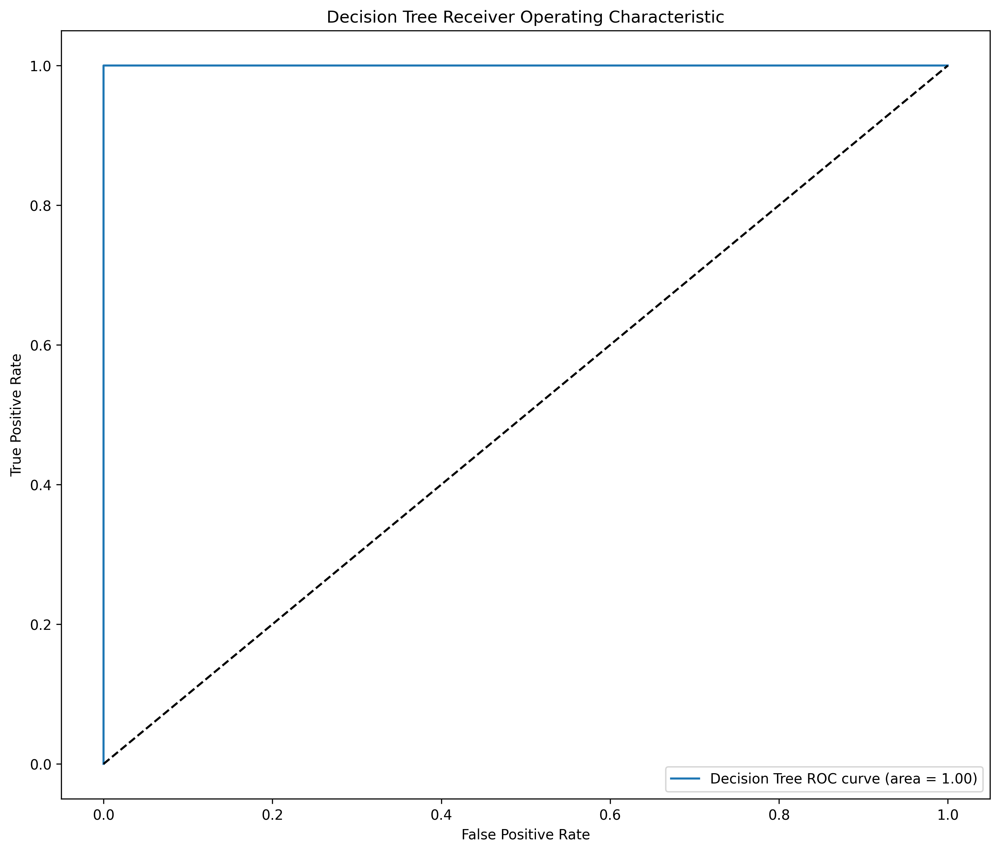

Random Forest accuracy: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       467
           1       1.00      0.97      0.99        34

    accuracy                           1.00       501
   macro avg       1.00      0.99      0.99       501
weighted avg       1.00      1.00      1.00       501



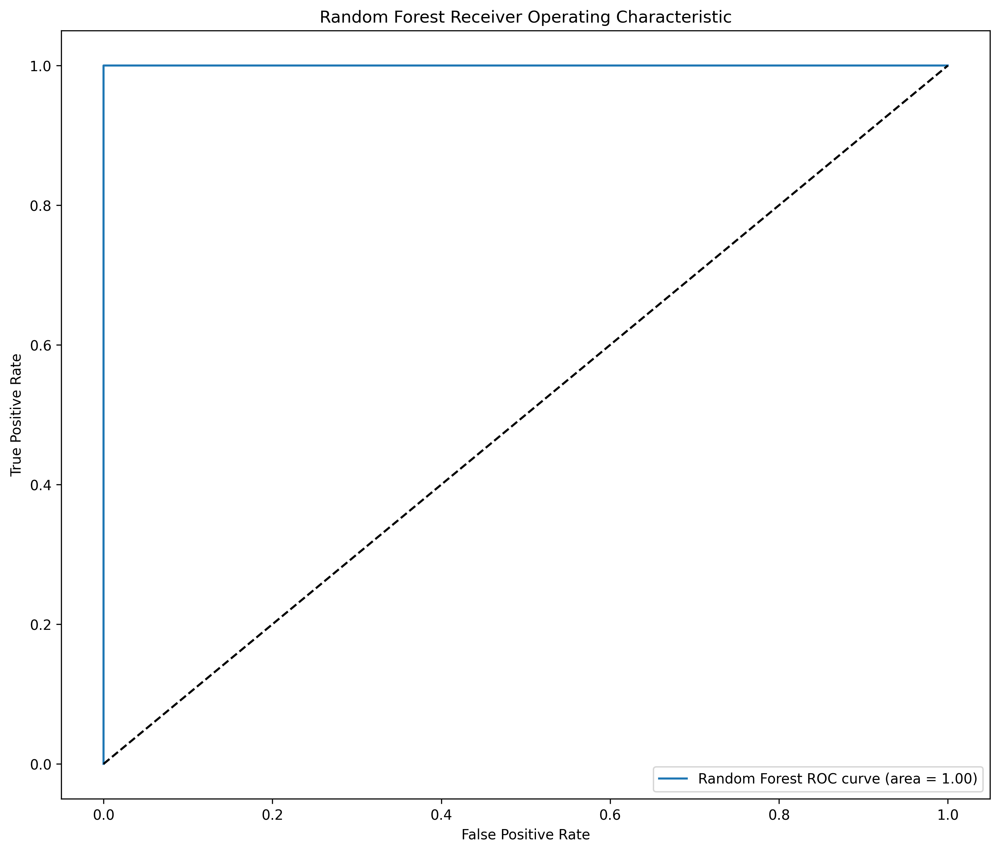

SVM accuracy: 0.98
              precision    recall  f1-score   support

           0       0.98      1.00      0.99       467
           1       1.00      0.74      0.85        34

    accuracy                           0.98       501
   macro avg       0.99      0.87      0.92       501
weighted avg       0.98      0.98      0.98       501



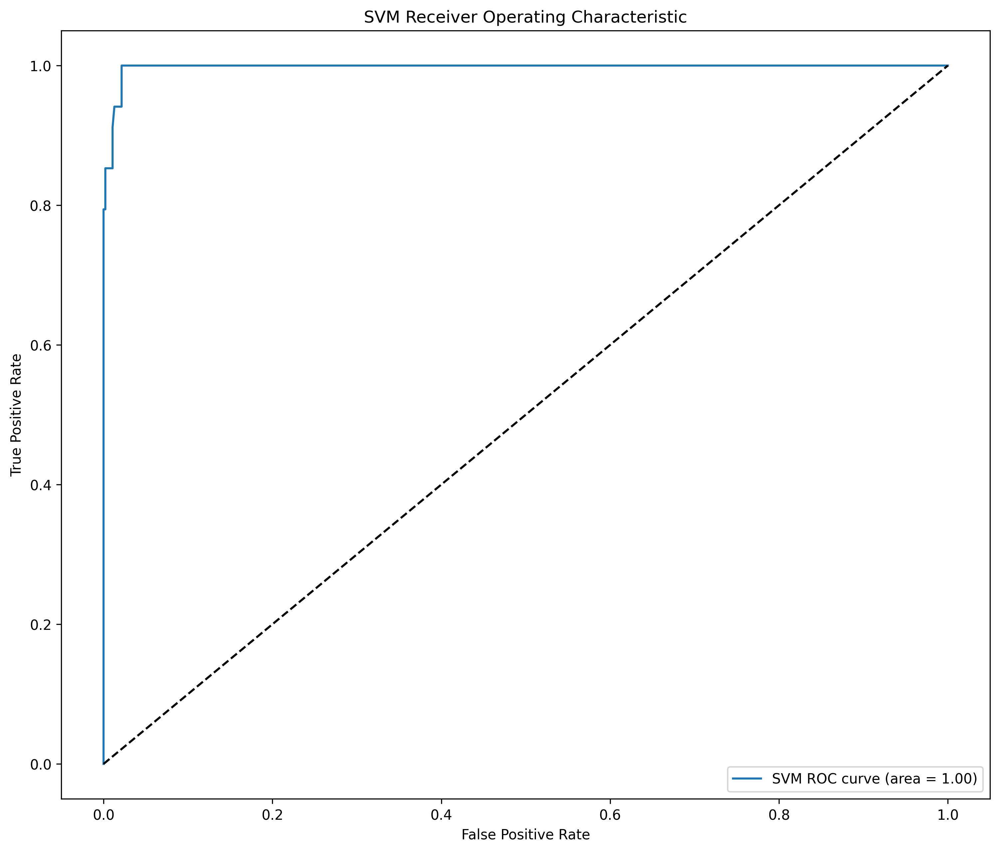

Gradient Boosting accuracy: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       467
           1       1.00      1.00      1.00        34

    accuracy                           1.00       501
   macro avg       1.00      1.00      1.00       501
weighted avg       1.00      1.00      1.00       501



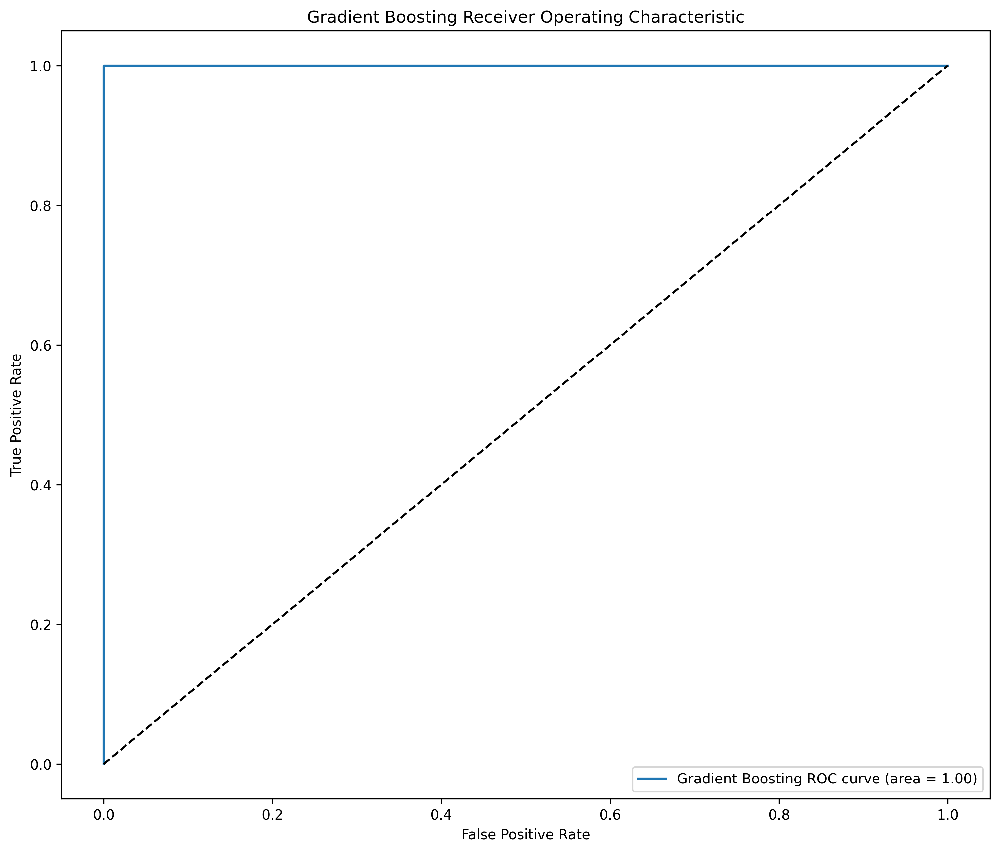

K-Nearest Neighbors accuracy: 0.99
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       467
           1       1.00      0.79      0.89        34

    accuracy                           0.99       501
   macro avg       0.99      0.90      0.94       501
weighted avg       0.99      0.99      0.99       501



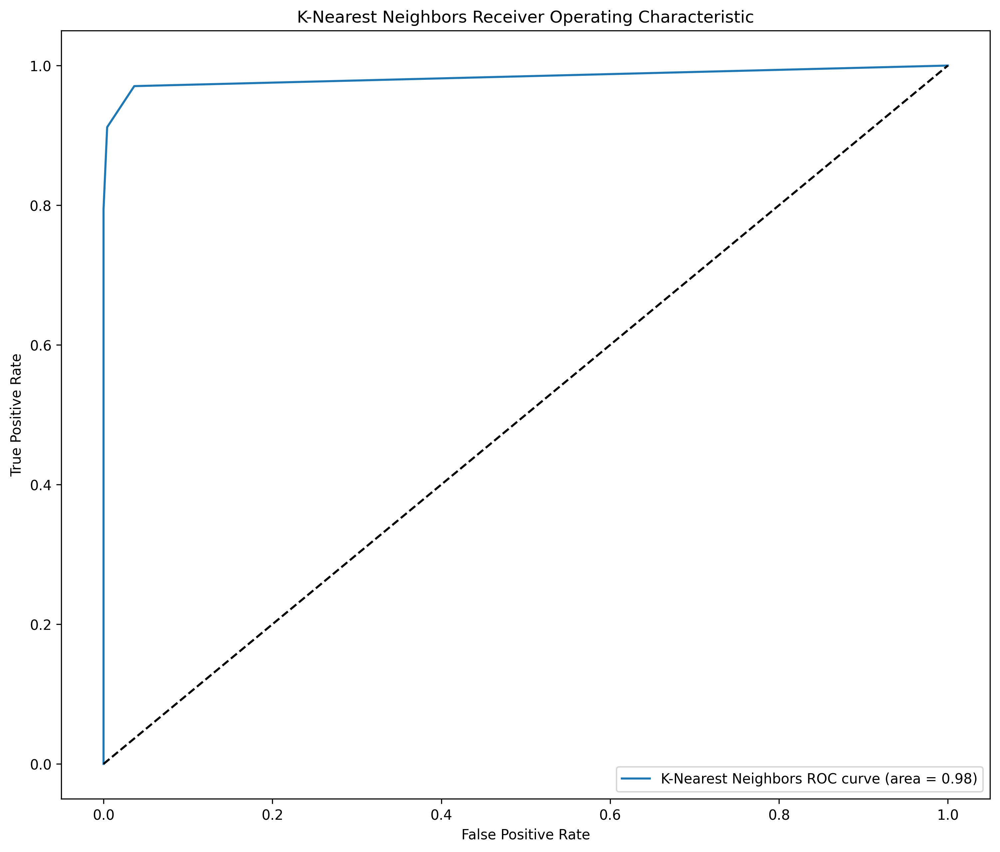

Naive Bayes accuracy: 1.00
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       467
           1       1.00      0.97      0.99        34

    accuracy                           1.00       501
   macro avg       1.00      0.99      0.99       501
weighted avg       1.00      1.00      1.00       501



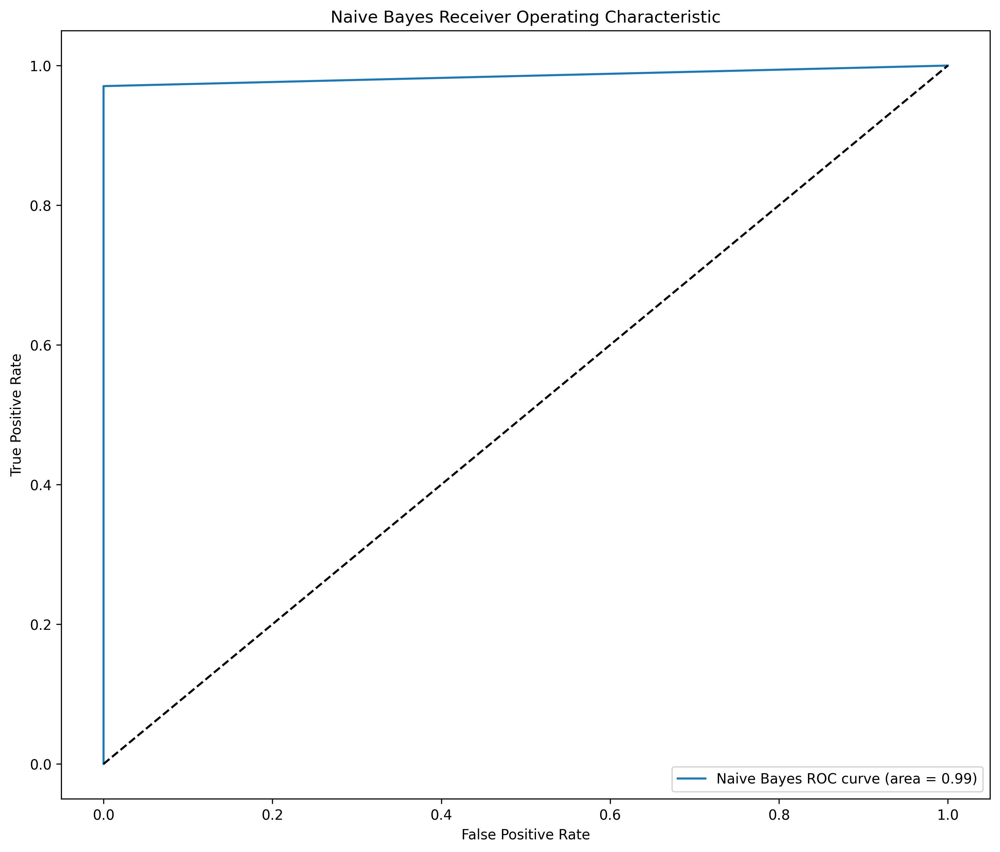

[LightGBM] [Info] Number of positive: 116, number of negative: 1886
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004315 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23711
[LightGBM] [Info] Number of data points in the train set: 2002, number of used features: 94
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.057942 -> initscore=-2.788623
[LightGBM] [Info] Start training from score -2.788623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

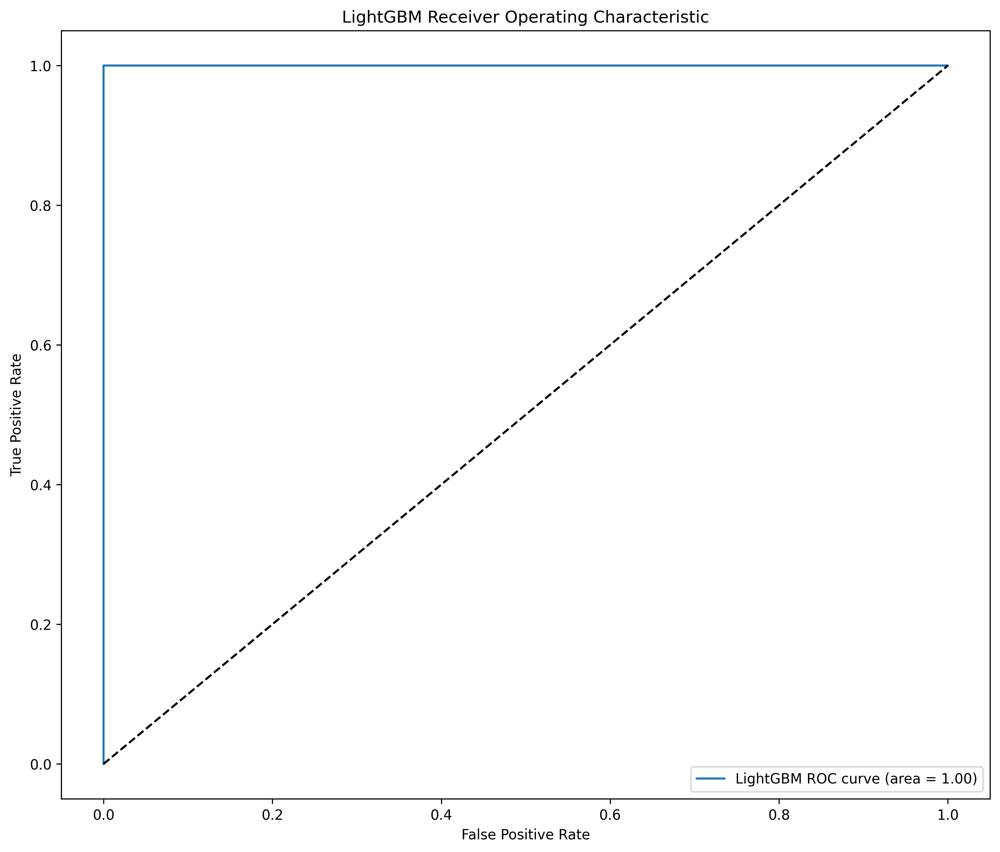

In [ ]:
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)[:, 1] if hasattr(model, "predict_proba") else model.decision_function(X_test)
    print(f"{name} accuracy: {model.score(X_test, y_test):.2f}")
    print(classification_report(y_test, y_pred))
    roc_auc = roc_auc_score(y_test, y_proba)
    fpr, tpr, _ = roc_curve(y_test, y_proba)
    plt.figure()
    plt.plot(fpr, tpr, label=f'{name} ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'{name} Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()